# <p><center style="font-family:newtimeroman;font-size:180%;">AirLine Passenger Satisfaction 🕵️‍♂️🕵️‍♂️</center></p>

### Team Members 🕵️‍♂️🕵️‍♂️:

1. Ahmed Ashraf Ahmed Alsayed (Leader)
2. Ahmed Elsayed Ahmed Hassan (اجبارى)
3. Radwa Mohamed Said Abd El- Shafi (Meme Lord)
4. Abdelrahman Abdo Hassan Ahmed

### Table of contents 🕵️‍♂️🕵️‍♂️:

* [Introduction 🕵️‍♂️🕵️‍♂️](#0)
* [Import Libraries 🕵️‍♂️🕵️‍♂️](#1)
* [Read Data 🕵️‍♂️🕵️‍♂️](#2)
* [EDA 🕵️‍♂️🕵️‍♂️](#3)
* [PreProcessing 🕵️‍♂️🕵️‍♂️](#4)
* [ML Models 🕵️‍♂️🕵️‍♂️](#5)
* [DL Models 🕵️‍♂️🕵️‍♂️](#6)

**<a id="0"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Introduction 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

                               Dataset
Context

This dataset contains an airline passenger satisfaction survey. What factors are highly correlated to a satisfied (or dissatisfied) passenger? Can you predict passenger satisfaction?

Content

Gender: Gender of the passengers (Female, Male)

Customer Type: The customer type (Loyal customer, disloyal customer)

Age: The actual age of the passengers

Type of Travel: Purpose of the flight of the passengers (Personal Travel, Business Travel)

Class: Travel class in the plane of the passengers (Business, Eco, Eco Plus)

Flight distance: The flight distance of this journey

Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

Departure/Arrival time convenient: Satisfaction level of Departure/Arrival time convenient

Ease of Online booking: Satisfaction level of online booking

Gate location: Satisfaction level of Gate location

Food and drink: Satisfaction level of Food and drink

Online boarding: Satisfaction level of online boarding

Seat comfort: Satisfaction level of Seat comfort

Inflight entertainment: Satisfaction level of inflight entertainment

On-board service: Satisfaction level of On-board service

Leg room service: Satisfaction level of Leg room service

Baggage handling: Satisfaction level of baggage handling

Check-in service: Satisfaction level of Check-in service

Inflight service: Satisfaction level of inflight service

Cleanliness: Satisfaction level of Cleanliness

Departure Delay in Minutes: Minutes delayed when departure

Arrival Delay in Minutes: Minutes delayed when Arrival

Satisfaction: Airline satisfaction level(Satisfaction, neutral or dissatisfaction)

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Import Libraries 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [1]:
import pandas as pd
import numpy as np
from plotly.offline import init_notebook_mode
import plotly.graph_objs as go
import cufflinks as cf
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
init_notebook_mode(connected=True)
cf.go_offline()
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
from sklearn.metrics import classification_report
import warnings
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler,Normalizer
from sklearn.feature_selection import SelectFromModel
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import roc_curve,RocCurveDisplay
from sklearn.metrics import auc
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_validate
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import PolynomialFeatures
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.decomposition import PCA
import keras
warnings.filterwarnings('ignore')

2024-05-09 01:18:47.285372: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-09 01:18:47.285510: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-09 01:18:47.457095: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


**<a id="2"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Read Data 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

> Read in the csv file as a dataframe called data

    The tabulated data is meticulously arranged, featuring distinct columns housing a range of diverse information. Column values are delimited by semicolons (;), hinting at the possibility that the data has been stored in CSV format, utilizing commas to separate values.

In [2]:
data=pd.read_csv('/kaggle/input/airline-passenger-satisfaction/train.csv')
data.drop('Unnamed: 0',axis=1,inplace=True)

> Check the head of data

In [3]:
data.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


> Check the shape of data

In [4]:
data.shape

(103904, 24)

    The dataset comprises 103,904 rows and 24 columns

> Check the info of data

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 103904 non-null  int64  
 1   Gender                             103904 non-null  object 
 2   Customer Type                      103904 non-null  object 
 3   Age                                103904 non-null  int64  
 4   Type of Travel                     103904 non-null  object 
 5   Class                              103904 non-null  object 
 6   Flight Distance                    103904 non-null  int64  
 7   Inflight wifi service              103904 non-null  int64  
 8   Departure/Arrival time convenient  103904 non-null  int64  
 9   Ease of Online booking             103904 non-null  int64  
 10  Gate location                      103904 non-null  int64  
 11  Food and drink                     1039

    The dataset includes 1 columns of floating-point values, 18 columns of integers, and 5 columns of object data types.

>Description of data

    If the DataFrame contains numerical data, the description contains these information for each column:

    count - The number of not-empty values.
    mean - The average (mean) value.
    std - The standard deviation.
    min - the minimum value.
    25% - The 25% percentile*.
    50% - The 50% percentile*.
    75% - The 75% percentile*.
    max - the maximum value.

In [6]:
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
id,103904.0,64924.210502,37463.812252,1.0,32533.75,64856.5,97368.25,129880.0
Age,103904.0,39.379706,15.114964,7.0,27.00,40.0,51.00,85.0
Flight Distance,103904.0,1189.448375,997.147281,31.0,414.00,843.0,1743.00,4983.0
Inflight wifi service,103904.0,2.729683,1.327829,0.0,2.00,3.0,4.00,5.0
Departure/Arrival time convenient,103904.0,3.060296,1.525075,0.0,2.00,3.0,4.00,5.0
Ease of Online booking,103904.0,2.756901,1.398929,0.0,2.00,3.0,4.00,5.0
Gate location,103904.0,2.976883,1.277621,0.0,2.00,3.0,4.00,5.0
Food and drink,103904.0,3.202129,1.329533,0.0,2.00,3.0,4.00,5.0
Online boarding,103904.0,3.250375,1.349509,0.0,2.00,3.0,4.00,5.0
Seat comfort,103904.0,3.439396,1.319088,0.0,2.00,4.0,5.00,5.0


    For object data types, the describe method typically includes:

    Count: The number of non-empty values.
    Unique: The number of unique values.
    Top: The most frequently occurring value.
    Freq: The frequency of the top value.

In [7]:
data.describe(include='O').transpose()

,count,unique,top,freq
Gender,103904,2,Female,52727
Customer Type,103904,2,Loyal Customer,84923
Type of Travel,103904,2,Business travel,71655
Class,103904,3,Business,49665
satisfaction,103904,2,neutral or dissatisfied,58879


>check for null values in the data


In [8]:
is_null,precentage = data.isnull().sum(),(data.isnull().sum()/data.shape[0])*100
df = pd.DataFrame()
df['Count'],df['Precentage%']=is_null,precentage
df

,Count,Precentage%
id,0,0.000000
Gender,0,0.000000
Customer Type,0,0.000000
Age,0,0.000000
Type of Travel,0,0.000000
Class,0,0.000000
Flight Distance,0,0.000000
Inflight wifi service,0,0.000000
Departure/Arrival time convenient,0,0.000000
Ease of Online booking,0,0.000000


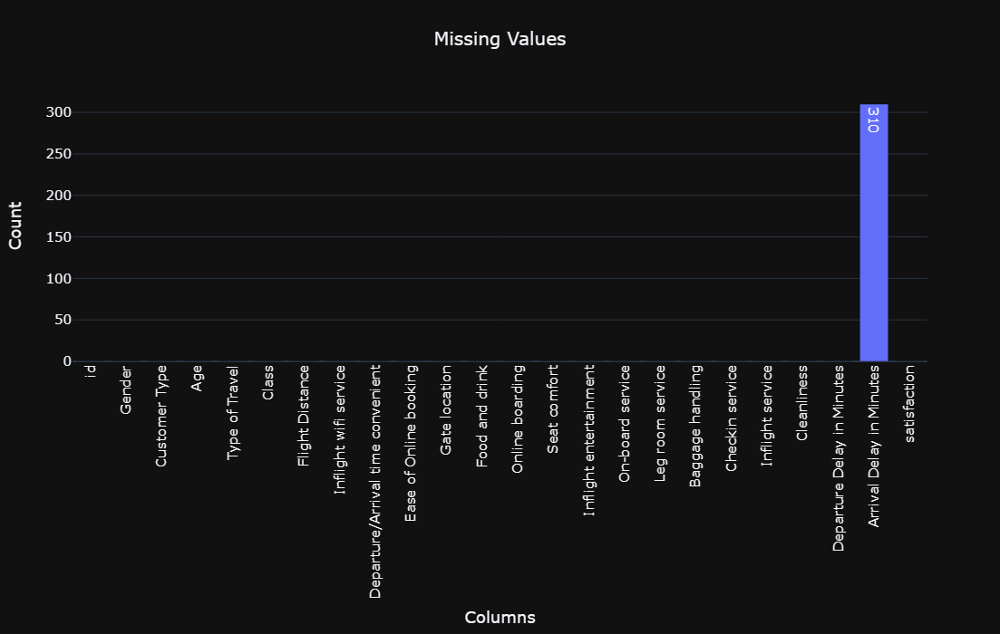

In [9]:
fig = go.Figure()
distribution = df['Count']
bar_trace = go.Bar(x=distribution.index, y=distribution.values, name="Missing Values",text=distribution.values, textposition='inside')
fig.add_trace(bar_trace)
fig.update_layout(
    title_text='Missing Values',
    title_x=0.5,
    title_font=dict(size=20),
    xaxis_title="Columns",
    yaxis_title='Count',
    font=dict(size=15),
    width=1000,
    height=700,
    xaxis=dict(tickangle=-90),
    template='plotly_dark'
)
fig.update_annotations(font=dict(size=20))
fig.show()

    Based on the provided data frame:
    
    The "Arrival Delay in Minutes" attribute has 310 missing values, which constitute approximately 0.298% of the observations.

> Handle null values

    To handle null values in your dataset, you can use various methods depending on the type of data and the nature of the missing values. Here are some common approaches for both numerical and categorical data:

    For Numerical Data:
    1. Mean/Median Imputation: Replace missing values with the mean or median of the column.
    2. Random Imputation: Replace missing values with randomly sampled values from the distribution of the existing data.
    3. Predictive Imputation: Use a predictive model to predict missing values based on other variables in the dataset.

    For Categorical Data:
    1. Most Frequent Imputation: Replace missing values with the most frequent value in the column.
    2. Constant Imputation: Replace missing values with a specific constant value.
    3. Predictive Imputation: You can also use a predictive model tailored for categorical data to predict missing values.

    Best Practices:
    In this case i willo drop null values 

In [10]:
data.dropna(inplace=True)

In [11]:
is_null,precentage = data.isnull().sum(),(data.isnull().sum()/data.shape[0])*100
df = pd.DataFrame()
df['Count'],df['Precentage%']=is_null,precentage
df

,Count,Precentage%
id,0,0.0
Gender,0,0.0
Customer Type,0,0.0
Age,0,0.0
Type of Travel,0,0.0
Class,0,0.0
Flight Distance,0,0.0
Inflight wifi service,0,0.0
Departure/Arrival time convenient,0,0.0
Ease of Online booking,0,0.0


>check duplicate data

    data[data.duplicated(keep=False)]
    returns all rows in the DataFrame that are duplicates, including both the original rows and their duplicates. The `keep=False` parameter ensures that all instances of duplicate rows are returned. If a row appears more than once in the DataFrame, it will be included in the output. 

In [12]:
data[data.duplicated(keep=False)]

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction


    keep='first': When you use data.duplicated(keep='first')
    it identifies and marks duplicates in the DataFrame, keeping only the first occurrence of each duplicated row as non-duplicate.

In [13]:
data[data.duplicated(keep='first')]

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction


    keep='last': Conversely, when you use data.duplicated(keep='last')
    it also identifies and marks duplicates in the DataFrame. However, it keeps only the last occurrence of each duplicated row as non-duplicate.

In [14]:
data[data.duplicated(keep='last')]

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction


**<a id="3"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">EDA 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

    Exploratory Data Analysis (EDA) is a crucial step in data analysis where you explore and summarize key characteristics of a dataset. This process involves techniques to gain insights, identify patterns, detect anomalies, and test hypotheses. Common methods used in EDA include summary statistics, data visualization (like histograms, scatter plots, box plots).

    Helper Functions

In [15]:
def hist_hue(feature,hue,title_f,title_h,title):
    num_bins=20
    total_hist, _ = np.histogram(data[feature], bins=num_bins)
    fig = make_subplots(rows=1, cols=2, subplot_titles=(title_f, f"{title_f} VS {title_h}"))
    histogram_trace_total = go.Bar(x=np.arange(num_bins), y=total_hist, name=title_f, text=total_hist, textposition='inside')
    fig.add_trace(histogram_trace_total, row=1, col=1)
    for category in data[hue].unique():
        category_data = data[data[hue] == category][feature]
        category_hist, _ = np.histogram(category_data, bins=num_bins)
        histogram_trace_by_hue = go.Bar(x=np.arange(num_bins), y=category_hist, name=f'{title_f} VS {title_h} ({category})', text=category_hist, textposition='inside')
        fig.add_trace(histogram_trace_by_hue, row=1, col=2)
    fig.update_layout(
       title_text=title,
       title_x=0.5, 
       title_font=dict(size=20),
       font=dict(size=15),
       width=1000,
       height=700,
       barmode='stack',
       template='plotly_dark',
        xaxis_title=title_f,
        yaxis_title='Count',
        xaxis2_title=title_f,
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [16]:
def Bar_hue(feature,hue,title_f,title_h,title):
    fig = make_subplots(rows=1, cols=2, subplot_titles=(title_f, f"{title_f} VS {title_h}"))
    distribution = data[feature].value_counts()
    bar_trace = go.Bar(x=distribution.index, y=distribution.values, name=title_f,text=distribution.values, textposition='inside')
    fig.add_trace(bar_trace, row=1, col=1)
    for category in data[hue].unique():
        category_data = data[data[hue] == category][feature].value_counts()
        bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h} ({category})', text=category_data.values, textposition='inside')
        fig.add_trace(bar_trace_by_hue, row=1, col=2)
    fig.update_layout(
        title_text=title,
        title_x=0.5,
        title_font=dict(size=20),
        xaxis_title=title_f,
        yaxis_title='Count',
        xaxis2_title=title_f,
        font=dict(size=15), 
        barmode='stack',
        width=1100,
        height=700,
        xaxis=dict(tickangle=-90),
        xaxis2=dict(tickangle=-90),
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [17]:
def Bar_2hue(feature,hue1,title_f,title_h1,title='',make_subplot=True,hue2='',title_h2=''):
    if make_subplot:
        fig = make_subplots(rows=1, cols=2, subplot_titles=(f"{title_f} VS {title_h1}",f"{title_f} VS {title_h2}"))
        for category in data[hue1].unique():
            category_data = data[data[hue1] == category][feature].value_counts()
            bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h1} ({category})',text=category_data.values, textposition='inside')
            fig.add_trace(bar_trace_by_hue, row=1, col=1)
        for category in data[hue2].unique():
            category_data = data[data[hue2] == category][feature].value_counts()
            bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h2} ({category})',text=category_data.values, textposition='inside')
            fig.add_trace(bar_trace_by_hue, row=1, col=2)
        fig.update_layout(
            title_text=title,
            title_x=0.5,
            title_font=dict(size=20),
            xaxis_title=title_f,
            yaxis_title='Count',
            xaxis2_title=title_f,
            font=dict(
                size=15,
            ),   
            barmode='stack',
            width=1100,
            height=700,
            xaxis=dict(tickangle=-90),
            xaxis1=dict(tickangle=-90),
            xaxis2=dict(tickangle=-90),
            template='plotly_dark'
        )
        fig.update_annotations(font=dict(size=20))
        fig.show()
    else: 
        fig = go.Figure()
        for category in data[hue1].unique():
            category_data = data[data[hue1] == category][feature].value_counts()
            bar_trace_by_hue = go.Bar(x=category_data.index, y=category_data.values, name=f'{title_f} VS {title_h1} ({category})',text=category_data.values, textposition='inside')
            fig.add_trace(bar_trace_by_hue)
        fig.update_layout(
            title_text=f'{title_f} VS {title_h1}',
            title_x=0.5,
            title_font=dict(size=20),
            xaxis_title=title_f,
            yaxis_title='Count',
            font=dict(
                size=15,
            ),   
            barmode="stack",
            width=800,
            height=700,
            xaxis=dict(tickangle=-90),
            template='plotly_dark'
        )
        fig.update_annotations(font=dict(size=20))
        fig.show()

In [18]:
def Boxplot_outlier(feature,title):
    fig = make_subplots(rows=1, cols=2, subplot_titles=("Box Plot", "Violin Plot"))
    fig.add_trace(
        go.Box(y=data[feature], name='BoxPlot'),
        row=1, col=1
    )
    fig.add_trace(
        go.Violin(y=data[feature], name='ViolinPlot'),
        row=1, col=2
    )
    fig.update_layout(
        title_text=title,
        title_x=0.5,
        title_font=dict(size=20),
        font=dict(size=15),
        width=1000,
        height=500,
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [19]:
def Pie(feature,title_f,title):
    distribution = data[feature].value_counts()
    pie_trace = go.Pie(labels=distribution.index, values=distribution.values, name=title_f)
    pie_layout = go.Layout(
        title=title,
        title_font=dict(size=20),
        width=600,
        height=500,
        title_x=0.5,
        template='plotly_dark'
    )
    fig_pie = go.Figure(data=[pie_trace], layout=pie_layout)
    fig_pie.show()

In [20]:
def Heatmap(pivot1, title, feature, feature_h1, make_subplot=True, feature_h2='', pivot2='', color='inferno'):
    fig_heatmap = None  
    if make_subplot:
        fig = make_subplots(rows=1, cols=2, subplot_titles=(f"{feature} VS {feature_h1}", f"{feature} VS {feature_h2}"))
        heat1 = go.Heatmap(
            z=pivot1.values,
            x=pivot1.columns,
            y=pivot1.index,
            colorscale=color,
            colorbar=dict(title='Count'),  
            colorbar_x=0.45,  
            colorbar_len=0.8  
        )
        fig.add_trace(heat1, row=1, col=1)
        heat2 = go.Heatmap(
            z=pivot2.values,
            x=pivot2.columns,
            y=pivot2.index,
            colorscale=color,
            colorbar=dict(title='Count'),  
            colorbar_x=1,  
            colorbar_len=0.8
        )
        fig.add_trace(heat2, row=1, col=2)
        fig.update_layout(
            title=title,
            title_x=0.5,
            title_font=dict(size=20),
            width=1100,
            height=500,
            xaxis=dict(title=feature_h1, tickangle=-90),
            xaxis2=dict(title=feature_h2, tickangle=-90),
            yaxis=dict(title=feature, tickangle=-90),
            yaxis2=dict(tickangle=-90),
            font=dict(size=15),
            template='plotly_dark'
        )
        fig_heatmap = fig  
    else:
        fig_heatmap = go.Figure(data=go.Heatmap(
            z=pivot1.values,
            x=pivot1.columns,
            y=pivot1.index,
            colorscale=color,
            colorbar=dict(title='Count')
        ))
        fig_heatmap.update_layout(
            title=title,
            title_x=0.5,
            title_font=dict(size=20),
            xaxis=dict(title=feature_h1),
            yaxis=dict(title=feature),
            font=dict(size=15),
            width=800,
            height=500,
            template='plotly_dark'
        )
    fig_heatmap.update_annotations(font=dict(size=20))
    fig_heatmap.show()

In [21]:
def mean(pivot_table,pivot_table1,feature,hue1,hue2,title,title_f):
    fig = make_subplots(rows=1, cols=2, subplot_titles=(f"Average {title_f} VS {hue1}", f"Average {title_f} VS {hue2}"))
    for i in data[hue1].unique():
        cate = pivot_table[pivot_table.index==i]
        bar_trace = go.Bar(x=cate.index, y=cate[feature], text=round(cate[feature],2), textposition='inside', name=i)
        fig.add_trace(bar_trace, row=1, col=1)
    for i in data[hue2].unique():
        cate = pivot_table1[pivot_table1.index==i]
        bar_trace = go.Bar(x=cate.index, y=cate[feature], text=round(cate[feature],2), textposition='inside', name=i)
        fig.add_trace(bar_trace, row=1, col=2)
    fig.update_layout(
        title_text=title,
        title_x=0.5,
        title_font=dict(size=20),
        xaxis_title=hue1,
        yaxis_title='Average',
        xaxis2_title=hue2,
        font=dict(size=15),
        barmode='stack',
        width=1100,
        height=700,
        xaxis=dict(tickangle=-90),
        xaxis1=dict(tickangle=-90),
        template='plotly_dark'
    )
    
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [22]:
def pivot(values_f,index_f,mean=True):
    if mean:
        return pd.pivot_table(data, values=values_f, index=index_f, aggfunc='mean')
    else:
        return pd.pivot_table(data, index=values_f, columns=index_f, aggfunc='size', fill_value=0)
def cross_t(index,columns):
    return pd.crosstab(index=data[index], columns=data[columns])

> What is age distribution?

    Find the minimum age

In [23]:
data.Age.min()

7

    Find the maximum age

In [24]:
data.Age.max()

85

    Find the top 5 most frequent ages

In [25]:
data['Age'].value_counts().head(5)

Age
39    2961
25    2790
40    2569
44    2479
42    2453
Name: count, dtype: int64

    Based on the output, it seems that the age group 31 to 36 has the highest counts of observations. Specifically, for ages 25, 39, 40, 44, and 42, the number of observations (count) is as follows:

    Age 25: 2790 observations
    Age 39: 2961 observations
    Age 40: 2569 observations
    Age 42: 2453 observations
    Age 44: 2479 observations

    calculate the mean age for each category in the "satisfaction" column

In [26]:
pivot_table = pivot('Age','satisfaction')
pivot_table

,Age
satisfaction,
neutral or dissatisfied,37.569126
satisfied,41.748558


    Visualization 

In [27]:
hist_hue('Age','satisfaction','Age','Satisfaction','Age Distribution')

In [28]:
Boxplot_outlier('Age','Age Distribution')

    Observation: Based on the figure, it appears that the "age" column don't contains outliers. 

> What is Gender distribution?

    calculate the value counts for the "Gender" column 

In [29]:
data.Gender.value_counts().to_frame()

,count
Gender,
Female,52576
Male,51018


     count the occurrences of each combination of Gender and satisfaction

In [30]:
pivot_table = pivot('Gender','satisfaction',False)
pivot_table

satisfaction,neutral or dissatisfied,satisfied
Gender,,
Female,30107,22469
Male,28590,22428


    Visualization

In [31]:
Pie('Gender','Gender','Gender Distribution')

In [32]:
Bar_hue('Gender','satisfaction','Gender','Satisfaction','Gender Distribution')

In [33]:
Heatmap(pivot_table,'Gender VS Satisfaction Categories','Gender','Satisfaction',make_subplot=False)

    observation based on figure: show frequency between Gender and Satisfaction   

> What is Customer Type distribution?

    calculate the value counts for the "Customer Type" column

In [34]:
data['Customer Type'].value_counts().to_frame()

,count
Customer Type,
Loyal Customer,84662
disloyal Customer,18932


     count the occurrences of each combination of Customer Type and satisfaction

In [35]:
pivot_table = pivot('Customer Type','satisfaction',False)
pivot_table

satisfaction,neutral or dissatisfied,satisfied
Customer Type,,
Loyal Customer,44249,40413
disloyal Customer,14448,4484


    count the occurrences of each combination of Customer Type and Gender 

In [36]:
pivot_table1 = pivot('Customer Type','Gender',False)
pivot_table1

Gender,Female,Male
Customer Type,,
Loyal Customer,42336,42326
disloyal Customer,10240,8692


     count the occurrences of each combination of Customer Type , Gender and y

In [37]:
data.groupby(['satisfaction','Gender','Customer Type'])['Customer Type'].count().to_frame()

Customer Type
satisfaction            Gender Customer Type                   
neutral or dissatisfied Female Loyal Customer             22182
                               disloyal Customer           7925
                        Male   Loyal Customer             22067
                               disloyal Customer           6523
satisfied               Female Loyal Customer             20154
                               disloyal Customer           2315
                        Male   Loyal Customer             20259
                               disloyal Customer           2169

    Visalization

In [38]:
Pie('Customer Type','Customer Type','Customer Type Distribution')

In [39]:
Bar_hue('Customer Type','satisfaction','Customer Type','Satisfaction','Customer Type Distribution')

In [40]:
Bar_2hue('Customer Type','Gender','Customer Type','Gender',make_subplot=False)

In [41]:
Heatmap(pivot_table,'Customer Type VS Satisfaction Categories','Customer Type','Satisfaction',make_subplot=False)

In [42]:
Heatmap(pivot_table1,'Customer Type VS Gender Categories','Customer Type','Gender',make_subplot=False)

> What is Type of Type of Travel distribution?

    calculate the value counts for the "Type of Travel" column

In [43]:
data['Type of Travel'].value_counts().to_frame()

,count
Type of Travel,
Business travel,71465
Personal Travel,32129


    count the occurrences of each combination of Type of Travel and satisfaction

In [44]:
pivot_table = pivot('Type of Travel','satisfaction',False)
pivot_table

satisfaction,neutral or dissatisfied,satisfied
Type of Travel,,
Business travel,29831,41634
Personal Travel,28866,3263


    count the occurrences of each combination of Type of Travel and Gender

In [45]:
pivot_table1 = pivot('Type of Travel','Gender',False)
pivot_table1

Gender,Female,Male
Type of Travel,,
Business travel,36433,35032
Personal Travel,16143,15986


    count the occurrences of each combination of Type of Travel and Customer Type

In [46]:
pivot_table2 = pivot('Type of Travel','Customer Type',False)
pivot_table2

Customer Type,Loyal Customer,disloyal Customer
Type of Travel,,
Business travel,52696,18769
Personal Travel,31966,163


     count the occurrences of each combination of Type of Travel , Gender , Customer Type and satisfaction	

In [47]:
data.groupby(['satisfaction','Gender','Customer Type','Type of Travel'])['Type of Travel'].count().to_frame()

Type of Travel
satisfaction            Gender Customer Type     Type of Travel                 
neutral or dissatisfied Female Loyal Customer    Business travel            7761
                                                 Personal Travel           14421
                               disloyal Customer Business travel            7853
                                                 Personal Travel              72
                        Male   Loyal Customer    Business travel            7760
                                                 Personal Travel           14307
                               disloyal Customer Business travel            6457
                                                 Personal Travel              66
satisfied               Female Loyal Customer    Business travel           18516
                                                 Personal Travel            1638
                               disloyal Customer Business travel            2303
                                                 Personal Travel              12
                        Male   Loyal Customer    Business travel           18659
                                                 Personal Travel            1600
                               disloyal Customer Business travel            2156
                                                 Personal Travel              13

    Visualization

In [48]:
Pie('Type of Travel','Type of Travel','Type of Travel Distribution')

In [49]:
Bar_hue('Type of Travel','satisfaction','Type of Travel','Satisfaction','Type of Travel Distribution')

In [50]:
Bar_2hue('Type of Travel','Gender','Travel','Gender',title='Type of Travel Distribution',hue2='Customer Type',title_h2='Customer Type')

In [51]:
Heatmap(pivot_table,'Type of Travel VS Satisfaction Categories','Type of Travel','Satisfaction',make_subplot=False)

In [52]:
Heatmap(pivot_table1,'Type of Travel VS Gender Categories','Type of Travel','Gender',make_subplot=False)

In [53]:
Heatmap(pivot_table2,'Type of Travel VS Customer Type Categories','Type of Travel','Customer Type',make_subplot=False)

> What is Type of Class distribution?

    calculate the value counts for the "Class" column

In [54]:
data.Class.value_counts().to_frame()

,count
Class,
Business,49533
Eco,46593
Eco Plus,7468


    count the occurrences of each combination of Class and satisfaction


In [55]:
pivot_table = pivot('Class','satisfaction',False)
pivot_table

satisfaction,neutral or dissatisfied,satisfied
Class,,
Business,15143,34390
Eco,37922,8671
Eco Plus,5632,1836


    count the occurrences of each combination of Class and Gender

In [56]:
pivot_table1 = pivot('Class','Gender',False)
pivot_table1 	

Gender,Female,Male
Class,,
Business,24868,24665
Eco,23776,22817
Eco Plus,3932,3536


    count the occurrences of each combination of Class and Customer Type

In [57]:
pivot_table2 = pivot('Class','Customer Type',False)
pivot_table2 	

Customer Type,Loyal Customer,disloyal Customer
Class,,
Business,42191,7342
Eco,35716,10877
Eco Plus,6755,713


    count the occurrences of each combination of Class and Type of Travel

In [58]:
pivot_table3 = pivot('Class','Type of Travel',False)
pivot_table3

Type of Travel,Business travel,Personal Travel
Class,,
Business,47384,2149
Eco,20202,26391
Eco Plus,3879,3589


     count the occurrences of each combination of Class , Type of Travel , Gender , Customer Type and satisfaction	

In [59]:
data.groupby(['satisfaction','Gender','Customer Type','Type of Travel','Class'])['Class'].count().to_frame()

Class
satisfaction            Gender Customer Type     Type of Travel  Class          
neutral or dissatisfied Female Loyal Customer    Business travel Business   4439
                                                                 Eco        2493
                                                                 Eco Plus    829
                                                 Personal Travel Business    935
                                                                 Eco       11826
                                                                 Eco Plus   1660
                               disloyal Customer Business travel Business   2313
                                                                 Eco        5025
                                                                 Eco Plus    515
                                                 Personal Travel Business      7
                                                                 Eco          65
                        Male   Loyal Customer    Business travel Business   4392
                                                                 Eco        2496
                                                                 Eco Plus    872
                                                 Personal Travel Business    939
                                                                 Eco       11754
                                                                 Eco Plus   1614
                               disloyal Customer Business travel Business   2114
                                                                 Eco        4205
                                                                 Eco Plus    138
                                                 Personal Travel Business      4
                                                                 Eco          58
                                                                 Eco Plus      4
satisfied               Female Loyal Customer    Business travel Business  15559
                                                                 Eco        2231
                                                                 Eco Plus    726
                                                 Personal Travel Business    130
                                                                 Eco        1351
                                                                 Eco Plus    157
                               disloyal Customer Business travel Business   1485
                                                                 Eco         773
                                                                 Eco Plus     45
                                                 Personal Travel Eco          12
                        Male   Loyal Customer    Business travel Business  15663
                                                                 Eco        2253
                                                                 Eco Plus    743
                                                 Personal Travel Business    134
                                                                 Eco        1312
                                                                 Eco Plus    154
                               disloyal Customer Business travel Business   1419
                                                                 Eco         726
                                                                 Eco Plus     11
                                                 Personal Travel Eco          13

    Visualization

In [60]:
Pie('Class','Class','Class Distribution')

In [61]:
Bar_hue('Class','satisfaction','Class','Satisfaction','Class Distribution')

In [62]:
Bar_2hue('Class','Gender','Class','Gender',title='Class Distribution',hue2='Customer Type',title_h2='Customer Type')

In [63]:
Bar_2hue('Class','Type of Travel','Class','Type of Travel',make_subplot=False)

In [64]:
Heatmap(pivot_table,'Class Distribution','Class','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=pivot_table1)

In [65]:
Heatmap(pivot_table2,'Class Distribution','Class','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=pivot_table3)

> What is Flight Distance distribution?

    Find the minimum Flight Distance

In [66]:
data['Flight Distance'].min()

31

    Find the maximum Flight Distance

In [67]:
data['Flight Distance'].max()

4983

    average the occurrences of each combination of Flight Distance and Type of Travel

In [68]:
pivot_table = pivot('Flight Distance','Type of Travel')
pivot_table

,Flight Distance
Type of Travel,
Business travel,1368.294872
Personal Travel,791.240375


        average the occurrences of each combination of Flight Distance and Class

In [69]:
pivot_table1 = pivot('Flight Distance','Class')
pivot_table1

,Flight Distance
Class,
Business,1676.078493
Eco,742.843281
Eco Plus,746.446438


    Visualization

In [70]:
Boxplot_outlier('Flight Distance','Flight Distance Distribution')

    Observation: Based on the figure, it appears that the "Flight Distance" column contains outliers. 

In [71]:
mean(pivot_table,pivot_table1,'Flight Distance','Type of Travel','Class','Average Flight Distance',title_f='Flight Distance')

> What is Type of Inflight wifi service distribution?

    calculate the value counts for the "Inflight wifi service" column

In [72]:
data['Inflight wifi service'].value_counts().to_frame()

,count
Inflight wifi service,
3,25789
2,25755
4,19737
1,17781
5,11436
0,3096


    count the occurrences of each combination of Inflight wifi service and satisfaction

In [73]:
cross = cross_t('Inflight wifi service','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Inflight wifi service,,
0,8,3088
1,11995,5786
2,19346,6409
3,19327,6462
4,7915,11822
5,106,11330


    count the occurrences of each combination of Inflight wifi service and Gender

In [74]:
cross1 = cross_t('Inflight wifi service','Gender')
cross1

Gender,Female,Male
Inflight wifi service,,
0,1590,1506
1,9056,8725
2,13212,12543
3,13141,12648
4,9885,9852
5,5692,5744


    count the occurrences of each combination of Inflight wifi service and Customer Type

In [75]:
cross2 = cross_t('Inflight wifi service','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Inflight wifi service,,
0,2403,693
1,14795,2986
2,20941,4814
3,20925,4864
4,15926,3811
5,9672,1764


    count the occurrences of each combination of Inflight wifi service and Type of Travel

In [76]:
cross3 = cross_t('Inflight wifi service','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Inflight wifi service,,
0,2449,647
1,12001,5780
2,16213,9542
3,16021,9768
4,14640,5097
5,10141,1295


    count the occurrences of each combination of Inflight wifi service and Class

In [77]:
cross4 = cross_t('Inflight wifi service','Class')
cross4

Class,Business,Eco,Eco Plus
Inflight wifi service,,,
0,1977,924,195
1,9014,7638,1129
2,11060,12761,1934
3,10834,13022,1933
4,9411,8815,1511
5,7237,3433,766


    Visualization

In [78]:
Pie('Inflight wifi service','Wifi service','Wifi service Distribution')

In [79]:
Bar_hue('Inflight wifi service','satisfaction','Wifi service','Satisfaction','Wifi service Distribution')

In [80]:
Bar_2hue('Inflight wifi service','Gender','Wifi service','Gender',title='Wifi service Distribution',hue2='Customer Type',title_h2='Customer')

In [81]:
Bar_2hue('Inflight wifi service','Type of Travel','Wifi service','Type of Travel',title='Wifi service Distribution',hue2='Class',title_h2='Class')

In [82]:
Heatmap(cross,'Wifi service Distribution','Wifi service','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [83]:
Heatmap(cross2,'Wifi service Distribution','Wifi service','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [84]:
Heatmap(cross4,'Wifi service Vs Class Categories','Wifi service','Class',make_subplot=False)

> What is Type of Departure/Arrival time convenient distribution?

    calculate the value counts for the "Departure/Arrival time convenient" column

In [85]:
data['Departure/Arrival time convenient'].value_counts().to_frame()

,count
Departure/Arrival time convenient,
4,25474
5,22333
3,17903
2,17142
1,15452
0,5290


    count the occurrences of each combination of Inflight wifi service and satisfaction

In [86]:
cross = cross_t('Departure/Arrival time convenient','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Departure/Arrival time convenient,,
0,2774,2516
1,7933,7519
2,9503,7639
3,10056,7847
4,15595,9879
5,12836,9497


    count the occurrences of each combination of Inflight wifi service and Gender

In [87]:
cross1 = cross_t('Departure/Arrival time convenient','Gender')
cross1

Gender,Female,Male
Departure/Arrival time convenient,,
0,2765,2525
1,7839,7613
2,8801,8341
3,9126,8777
4,12856,12618
5,11189,11144


    count the occurrences of each combination of Inflight wifi service and Customer Type

In [88]:
cross2 = cross_t('Departure/Arrival time convenient','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Departure/Arrival time convenient,,
0,2028,3262
1,12908,2544
2,13284,3858
3,14020,3883
4,21933,3541
5,20489,1844


    count the occurrences of each combination of Inflight wifi service and Type of Travel

In [89]:
cross3 = cross_t('Departure/Arrival time convenient','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Departure/Arrival time convenient,,
0,4422,868
1,12737,2715
2,14097,3045
3,14119,3784
4,14039,11435
5,12051,10282


    count the occurrences of each combination of Inflight wifi service and Class

In [90]:
cross4 = cross_t('Departure/Arrival time convenient','Class')
cross4

Class,Business,Eco,Eco Plus
Departure/Arrival time convenient,,,
0,2269,2785,236
1,8752,5634,1066
2,9407,6596,1139
3,9460,7210,1233
4,10237,13243,1994
5,9408,11125,1800


    Visualization

In [91]:
Pie('Departure/Arrival time convenient','Arrival time','Arrival timee Distribution')

In [92]:
Bar_hue('Departure/Arrival time convenient','satisfaction','Arrival time','Satisfaction','Arrival time Distribution')

In [93]:
Bar_2hue('Departure/Arrival time convenient','Gender','Arrival time','Gender',title='Arrival time Distribution',hue2='Customer Type',title_h2='Customer')

In [94]:
Bar_2hue('Departure/Arrival time convenient','Type of Travel','Arrival time','Type of Travel',title='Arrival time Distribution',hue2='Class',title_h2='Class')

In [95]:
Heatmap(cross,'Arrival time Distribution','Arrival time','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [96]:
Heatmap(cross2,'Arrival time Distribution','Arrival time','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [97]:
Heatmap(cross4,'Arrival time Vs Class Categories','Arrival time','Class',make_subplot=False)

> What is Type of Ease of Online booking distribution?

    calculate the value counts for the "Ease of Online booking" column

In [98]:
data['Ease of Online booking'].value_counts().to_frame()

,count
Ease of Online booking,
3,24370
2,23962
4,19508
1,17466
5,13815
0,4473


    count the occurrences of each combination of Ease of Online booking and satisfaction

In [99]:
cross = cross_t('Ease of Online booking','satisfaction') 
cross

satisfaction,neutral or dissatisfied,satisfied
Ease of Online booking,,
0,1500,2973
1,10897,6569
2,16673,7289
3,16858,7512
4,9152,10356
5,3617,10198


    count the occurrences of each combination of Ease of Online booking and Gender

In [100]:
cross1 = cross_t('Ease of Online booking','Gender')
cross1

Gender,Female,Male
Ease of Online booking,,
0,2293,2180
1,8895,8571
2,12318,11644
3,12338,12032
4,9773,9735
5,6959,6856


    count the occurrences of each combination of Ease of Online booking and Customer Type

In [101]:
cross2 = cross_t('Ease of Online booking','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Ease of Online booking,,
0,3616,857
1,14510,2956
2,19281,4681
3,19539,4831
4,15758,3750
5,11958,1857


    count the occurrences of each combination of Ease of Online booking and Type of Travel

In [102]:
cross3 = cross_t('Ease of Online booking','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Ease of Online booking,,
0,2677,1796
1,12076,5390
2,14968,8994
3,15148,9222
4,14466,5042
5,12130,1685


    count the occurrences of each combination of Ease of Online booking and Class

In [103]:
cross4 = cross_t('Ease of Online booking','Class')
cross4

Class,Business,Eco,Eco Plus
Ease of Online booking,,,
0,2089,2045,339
1,8193,7948,1325
2,9917,12208,1837
3,10096,12440,1834
4,10162,8065,1281
5,9076,3887,852


    Visualization

In [104]:
Pie('Ease of Online booking','Online booking','Online booking Distribution')

In [105]:
Bar_hue('Ease of Online booking','satisfaction','Online booking','Satisfaction','Online booking Distribution')

In [106]:
Bar_2hue('Ease of Online booking','Gender','Online booking','Gender',title='Online booking Distribution',hue2='Customer Type',title_h2='Customer')

In [107]:
Bar_2hue('Ease of Online booking','Type of Travel','Online booking','Type of Travel',title='Online booking Distribution',hue2='Class',title_h2='Class')

In [108]:
Heatmap(cross,'Online booking Distribution','Online booking','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [109]:
Heatmap(cross2,'Online booking Distribution','Online booking','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [110]:
Heatmap(cross4,'Online booking Vs Class Categories','Online booking','Class',make_subplot=False)

> What is Type of Gate location distribution?

    calculate the value counts for the "Gate location" column

In [111]:
data['Gate location'].value_counts().to_frame()

,count
Gate location,
3,28489
4,24353
2,19396
1,17511
5,13844
0,1


    count the occurrences of each combination of Gate location and satisfaction

In [112]:
cross = cross_t('Gate location','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Gate location,,
0,0,1
1,8834,8677
2,10447,8949
3,18600,9889
4,14895,9458
5,5921,7923


    count the occurrences of each combination of Ease of Online booking and Gender

In [113]:
cross1 = cross_t('Gate location','Gender')
cross1

Gender,Female,Male
Gate location,,
0,1,0
1,8821,8690
2,9821,9575
3,14586,13903
4,12450,11903
5,6897,6947


    count the occurrences of each combination of Ease of Online booking and Customer Type

In [114]:
cross2 = cross_t('Gate location','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Gate location,,
0,1,0
1,14933,2578
2,16376,3020
3,21878,6611
4,18970,5383
5,12504,1340


    count the occurrences of each combination of Ease of Online booking and Type of Travel

In [115]:
cross3 = cross_t('Gate location','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Gate location,,
0,1,0
1,12768,4743
2,13591,5805
3,17299,11190
4,16238,8115
5,11568,2276


    count the occurrences of each combination of Ease of Online booking and Class

In [116]:
cross4 = cross_t('Gate location','Class')
cross4

Class,Business,Eco,Eco Plus
Gate location,,,
0,1,0,0
1,9398,6885,1228
2,9782,8230,1384
3,11228,15093,2168
4,10507,12064,1782
5,8617,4321,906


    Visualization

In [117]:
Pie('Gate location','Gate location','Gate location Distribution')

In [118]:
Bar_hue('Gate location','satisfaction','Gate location','Satisfaction','Gate location Distribution')

In [119]:
Bar_2hue('Gate location','Gender','Gate location','Gender',title='Gate location Distribution',hue2='Customer Type',title_h2='Customer')

In [120]:
Bar_2hue('Gate location','Type of Travel','Gate location','Type of Travel',title='Gate location Distribution',hue2='Class',title_h2='Class')

In [121]:
Heatmap(cross,'Gate location Distribution','Gate location','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [122]:
Heatmap(cross2,'Gate location Distribution','Gate location','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [123]:
Heatmap(cross4,'Gate location Vs Class Categories','Gate location','Class',make_subplot=False)

> What is Type of Food and drink distribution?

    caculate the value counts for the "Food and drink" column


In [124]:
data['Food and drink'].value_counts().to_frame()

,count
Food and drink,
4,24294
5,22239
3,22238
2,21918
1,12800
0,105


    count the occurrences of each combination of Food and drink and satisfaction

In [125]:
cross = cross_t('Food and drink','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Food and drink,,
0,56,49
1,10237,2563
2,13407,8511
3,13427,8811
4,11535,12759
5,10035,12204


    count the occurrences of each combination of Food and drink and Gender

In [126]:
cross1 = cross_t('Food and drink','Gender')
cross1

Gender,Female,Male
Food and drink,,
0,55,50
1,6510,6290
2,11223,10695
3,11426,10812
4,12082,12212
5,11280,10959


    count the occurrences of each combination of Food and drink and Customer Type

In [127]:
cross2 = cross_t('Food and drink','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Food and drink,,
0,81,24
1,9436,3364
2,17996,3922
3,18276,3962
4,20353,3941
5,18520,3719


    count the occurrences of each combination of Food and drink and Type of Travel

In [128]:
cross3 = cross_t('Food and drink','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Food and drink,,
0,54,51
1,7796,5004
2,14965,6953
3,15252,6986
4,17611,6683
5,15787,6452


    count the occurrences of each combination of Food and drink and Class


In [129]:
cross4 = cross_t('Food and drink','Class')
cross4

Class,Business,Eco,Eco Plus
Food and drink,,,
0,31,56,18
1,4358,7341,1101
2,10569,9798,1551
3,10701,9947,1590
4,12379,10226,1689
5,11495,9225,1519


    Visualization

In [130]:
Pie('Food and drink','Food and drink','Food and drink Distribution')

In [131]:
Bar_hue('Food and drink','satisfaction','Food and drink','Satisfaction','Food and drink Distribution')

In [132]:
Bar_2hue('Food and drink','Gender','Food and drink','Gender',title='Food and drink Distribution',hue2='Customer Type',title_h2='Customer')

In [133]:
Bar_2hue('Food and drink','Type of Travel','Food and drink','Type of Travel',title='Food and drink Distribution',hue2='Class',title_h2='Class')

In [134]:
Heatmap(cross,'Food and drink Distribution','Food and drink','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [135]:
Heatmap(cross2,'Food and drink Distribution','Food and drink','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [136]:
Heatmap(cross4,'Food and drink Vs Class Categories','Food and drink','Class',make_subplot=False)

> What is Type of Online boarding distribution?

    calculate the value counts for the "Online boarding" column

In [137]:
data['Online boarding'].value_counts().to_frame()

,count
Online boarding,
4,30671
3,21744
5,20652
2,17449
1,10658
0,2420


    count the occurrences of each combination of Online boarding and satisfaction

In [138]:
cross = cross_t('Online boarding','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Online boarding,,
0,1073,1347
1,9187,1471
2,15437,2012
3,18790,2954
4,11562,19109
5,2648,18004


    count the occurrences of each combination of Online boarding and Gender


In [139]:
cross1 = cross_t('Online boarding','Gender')
cross1

Gender,Female,Male
Online boarding,,
0,1097,1323
1,5084,5574
2,8337,9112
3,11040,10704
4,16124,14547
5,10894,9758


    count the occurrences of each combination of Online boarding and Customer Type


In [140]:
cross2 = cross_t('Online boarding','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Online boarding,,
0,1601,819
1,7661,2997
2,12828,4621
3,16927,4817
4,26893,3778
5,18752,1900


    count the occurrences of each combination of Online boarding and Type of Travel


In [141]:
cross3 = cross_t('Online boarding','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Online boarding,,
0,1092,1328
1,6109,4549
2,10075,7374
3,13317,8427
4,23749,6922
5,17123,3529


    count the occurrences of each combination of Online boarding and Class


In [142]:
cross4 = cross_t('Online boarding','Class')
cross4

Class,Business,Eco,Eco Plus
Online boarding,,,
0,540,1614,266
1,2945,6706,1007
2,5019,10785,1645
3,7679,12202,1863
4,18685,10249,1737
5,14665,5037,950


    Visualization

In [143]:
Pie('Online boarding','Online boarding','Online boarding Distribution')

In [144]:
Bar_hue('Online boarding','satisfaction','Online boarding','Satisfaction','Online boarding Distribution')

In [145]:
Bar_2hue('Online boarding','Gender','Online boarding','Gender',title='Online boarding Distribution',hue2='Customer Type',title_h2='Customer')

In [146]:
Bar_2hue('Online boarding','Type of Travel','Online boarding','Type of Travel',title='Online boarding Distribution',hue2='Class',title_h2='Class')

In [147]:
Heatmap(cross,'Food and drink Distribution','Online boarding','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [148]:
Heatmap(cross2,'Online boarding Distribution','Online boarding','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [149]:
Heatmap(cross4,'Online boarding Vs Class Categories','Online boarding','Class',make_subplot=False)

> What is Seat comfort distribution?

    calculate the value counts for the "Seat comfort" column


In [150]:
data['Seat comfort'].value_counts().to_frame()

,count
Seat comfort,
4,31682
5,26393
3,18641
2,14846
1,12031
0,1


    count the occurrences of each combination of Seat comfort and satisfaction

In [151]:
cross = cross_t('Seat comfort','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Seat comfort,,
0,1,0
1,9341,2690
2,11516,3330
3,14697,3944
4,13907,17775
5,9235,17158


    count the occurrences of each combination of Seat comfort and Gender


In [152]:
cross1 = cross_t('Seat comfort','Gender')
cross1

Gender,Female,Male
Seat comfort,,
0,1,0
1,5714,6317
2,7152,7694
3,9663,8978
4,16568,15114
5,13478,12915


    count the occurrences of each combination of Seat comfort and Customer Type


In [153]:
cross2 = cross_t('Seat comfort','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Seat comfort,,
0,1,0
1,8305,3726
2,10954,3892
3,14842,3799
4,27888,3794
5,22672,3721


    count the occurrences of each combination of Seat comfort and Type of Travel


In [154]:
cross3 = cross_t('Seat comfort','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Seat comfort,,
0,1,0
1,6896,5135
2,9260,5586
3,12334,6307
4,23629,8053
5,19345,7048


    count the occurrences of each combination of Seat comfort and Class


In [155]:
cross4 = cross_t('Seat comfort','Class')
cross4

Class,Business,Eco,Eco Plus
Seat comfort,,,
0,1,0,0
1,3490,7448,1093
2,4843,8667,1336
3,7224,9782,1635
4,18440,11334,1908
5,15535,9362,1496


    Visualization

In [156]:
Pie('Seat comfort','Seat comfort','Seat comfort Distribution')

In [157]:
Bar_hue('Seat comfort','satisfaction','Seat comfort','Satisfaction','Seat comfort Distribution')

In [158]:
Bar_2hue('Seat comfort','Gender','Seat comfort','Gender',title='Seat comfort Distribution',hue2='Customer Type',title_h2='Customer')

In [159]:
Bar_2hue('Seat comfort','Type of Travel','Seat comfort','Type of Travel',title='Seat comfort Distribution',hue2='Class',title_h2='Class')

In [160]:
Heatmap(cross,'Seat comfort Distribution','Seat comfort','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [161]:
Heatmap(cross2,'Seat comfort Distribution','Seat comfort','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [162]:
Heatmap(cross4,'Seat comfort Vs Class Categories','Seat comfort','Class',make_subplot=False)

> What is Type of Inflight entertainment distribution?

    calculate the value counts for the "Inflight entertainment" column

In [163]:
data['Inflight entertainment'].value_counts().to_frame()

,count
Inflight entertainment,
4,29335
5,25145
3,19080
2,17579
1,12441
0,14


    count the occurrences of each combination of Inflight entertainment and satisfaction


In [164]:
cross = cross_t('Inflight entertainment','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Inflight entertainment,,
0,14,0
1,10701,1740
2,13829,3750
3,13934,5146
4,11381,17954
5,8838,16307


    count the occurrences of each combination of Inflight entertainment and Gender


In [165]:
cross1 = cross_t('Inflight entertainment','Gender')
cross1

Gender,Female,Male
Inflight entertainment,,
0,7,7
1,6365,6076
2,9011,8568
3,9748,9332
4,14707,14628
5,12738,12407



    count the occurrences of each combination of Inflight entertainment and Customer Type


In [166]:
cross2 = cross_t('Inflight entertainment','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Inflight entertainment,,
0,14,0
1,9059,3382
2,13750,3829
3,15105,3975
4,25344,3991
5,21390,3755


    count the occurrences of each combination of Inflight entertainment and Type of Travel

In [167]:
cross3 = cross_t('Inflight entertainment','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Inflight entertainment,,
0,14,0
1,6886,5555
2,11002,6577
3,12322,6758
4,22605,6730
5,18636,6509


    count the occurrences of each combination of Inflight entertainment and Class


In [168]:
cross4 = cross_t('Inflight entertainment','Class')
cross4

Class,Business,Eco,Eco Plus
Inflight entertainment,,,
0,6,3,5
1,3836,7486,1119
2,6567,9534,1478
3,7722,9763,1595
4,17074,10511,1750
5,14328,9296,1521


    Visualization

In [169]:
Pie('Inflight entertainment','Inflight entertainment','Inflight entertainment Distribution')

In [170]:
Bar_hue('Inflight entertainment','satisfaction','Inflight entertainment','Satisfaction','Inflight entertainment Distribution')

In [171]:
Bar_2hue('Inflight entertainment','Gender','Entertainment','Gender',title='Inflight entertainment Distribution',hue2='Customer Type',title_h2='Customer')

In [172]:
Bar_2hue('Inflight entertainment','Type of Travel','Entertainment','Type of Travel',title='Inflight entertainment Distribution',hue2='Class',title_h2='Class')

In [173]:
Heatmap(cross,'Inflight entertainment Distribution','Inflight entertainment','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [174]:
Heatmap(cross2,'Inflight entertainment Distribution','Inflight entertainment','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [175]:
Heatmap(cross4,'Inflight entertainment Vs Class Categories','Inflight entertainment','Class',make_subplot=False)

> What is On-board service distribution?

    calculate the value counts for the "On-board service" column

In [176]:
data['On-board service'].value_counts().to_frame()

,count
On-board service,
4,30773
5,23584
3,22770
2,14632
1,11832
0,3


    count the occurrences of each combination of On-board service and satisfaction

In [177]:
cross = cross_t('On-board service','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
On-board service,,
0,3,0
1,9541,2291
2,10890,3742
3,15583,7187
4,14246,16527
5,8434,15150


    count the occurrences of each combination of On-board service and Gender

In [178]:
cross1 = cross_t('On-board service','Gender')
cross1

Gender,Female,Male
On-board service,,
0,2,1
1,6039,5793
2,7783,6849
3,11352,11418
4,15352,15421
5,12048,11536


    count the occurrences of each combination of On-board service and Customer Type


In [179]:
cross2 = cross_t('On-board service','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
On-board service,,
0,3,0
1,9269,2563
2,12005,2627
3,17639,5131
4,25640,5133
5,20106,3478


    count the occurrences of each combination of On-board service and Type of Travel

In [180]:
cross3 = cross_t('On-board service','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
On-board service,,
0,3,0
1,7619,4213
2,10138,4494
3,14376,8394
4,22444,8329
5,16885,6699


    count the occurrences of each combination of On-board service and Class

In [181]:
cross4 = cross_t('On-board service','Class')
cross4

Class,Business,Eco,Eco Plus
On-board service,,,
0,3,0,0
1,3337,7246,1249
2,5417,7835,1380
3,9331,11624,1815
4,17127,11819,1827
5,14318,8069,1197


    Visualization

In [182]:
Pie('On-board service','On-board service','On-board service Distribution')

In [183]:
Bar_hue('On-board service','satisfaction','On-board service','Satisfaction','On-board service Distribution')

In [184]:
Bar_2hue('On-board service','Gender','On-board service','Gender',title='On-board service Distribution',hue2='Customer Type',title_h2='Customer')

In [185]:
Bar_2hue('On-board service','Type of Travel','On-board service','Type of Travel',title='On-board service Distribution',hue2='Class',title_h2='Class')

In [186]:
Heatmap(cross,'On-board service Distribution','On-board service','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [187]:
Heatmap(cross2,'On-board service Distribution','On-board service','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [188]:
Heatmap(cross4,'On-board service Vs Class Categories','On-board service','Class',make_subplot=False)

> What is Type of Leg room service distribution?

    calculate the value counts for the "Leg room service" column

In [189]:
data['Leg room service'].value_counts().to_frame()

,count
Leg room service,
4,28704
5,24599
3,20042
2,19469
1,10310
0,470


    count the occurrences of each combination of Leg room service and satisfaction

In [190]:
cross = cross_t('Leg room service','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Leg room service,,
0,304,166
1,8221,2089
2,14124,5345
3,14580,5462
4,11980,16724
5,9488,15111


    count the occurrences of each combination of Leg room service and Gender

In [191]:
cross1 = cross_t('Leg room service','Gender')
cross1

Gender,Female,Male
Leg room service,,
0,406,64
1,5363,4947
2,10120,9349
3,10273,9769
4,14458,14246
5,11956,12643



    count the occurrences of each combination of Leg room service and Customer Type

In [192]:
cross2 = cross_t('Leg room service','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Leg room service,,
0,470,0
1,8088,2222
2,15407,4062
3,15852,4190
4,24429,4275
5,20416,4183


    count the occurrences of each combination of Leg room service and Type of Travel

In [193]:
cross3 = cross_t('Leg room service','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Leg room service,,
0,71,399
1,6623,3687
2,11964,7505
3,12289,7753
4,21759,6945
5,18759,5840


    count the occurrences of each combination of Leg room service and Class

In [194]:
cross4 = cross_t('Leg room service','Class')
cross4

Class,Business,Eco,Eco Plus
Leg room service,,,
0,124,306,40
1,2867,6343,1100
2,7538,10293,1638
3,7793,10567,1682
4,16846,10258,1600
5,14365,8826,1408


    Visualization

In [195]:
Pie('Leg room service','Leg room service','Leg room service Distribution')

In [196]:
Bar_hue('Leg room service','satisfaction','Leg room service','Satisfaction','Leg room service Distribution')

In [197]:
Bar_2hue('Leg room service','Gender','Leg room service','Gender',title='Leg room service Distribution',hue2='Customer Type',title_h2='Customer')

In [198]:
Bar_2hue('Leg room service','Type of Travel','Leg room service','Type of Travel',title='Leg room service Distribution',hue2='Class',title_h2='Class')

In [199]:
Heatmap(cross,'Leg room service Distribution','Leg room service','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [200]:
Heatmap(cross2,'Leg room service Distribution','Leg room service','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [201]:
Heatmap(cross4,'Leg room service Vs Class Categories','Leg room service','Class',make_subplot=False)

> What is Type of Baggage handling distribution?

    calculate the value counts for the "Baggage handling" column

In [202]:
data['Baggage handling'].value_counts().to_frame()

,count
Baggage handling,
4,37274
5,27047
3,20567
2,11483
1,7223


    count the occurrences of each combination of Baggage handling and satisfaction

In [203]:
cross = cross_t('Baggage handling','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Baggage handling,,
1,5075,2148
2,8086,3397
3,15719,4848
4,19345,17929
5,10472,16575


    count the occurrences of each combination of Baggage handling and Gender

In [204]:
cross1 = cross_t('Baggage handling','Gender')
cross1

Gender,Female,Male
Baggage handling,,
1,4144,3079
2,6257,5226
3,10313,10254
4,18251,19023
5,13611,13436


    count the occurrences of each combination of Baggage handling and Customer Type

In [205]:
cross2 = cross_t('Baggage handling','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Baggage handling,,
1,6207,1016
2,9953,1530
3,16232,4335
4,29870,7404
5,22400,4647


    count the occurrences of each combination of Baggage handling and Type of Travel

In [206]:
cross3 = cross_t('Baggage handling','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Baggage handling,,
1,4419,2804
2,7825,3658
3,14215,6352
4,26431,10843
5,18575,8472


    count the occurrences of each combination of Baggage handling and Class

In [207]:
cross4 = cross_t('Baggage handling','Class')
cross4

Class,Business,Eco,Eco Plus
Baggage handling,,,
1,2416,4092,715
2,4616,5876,991
3,7227,11354,1986
4,19353,15508,2413
5,15921,9763,1363


    Visualization

In [208]:
Pie('Baggage handling','Baggage handling','Baggage handling Distribution')

In [209]:
Bar_hue('Baggage handling','satisfaction','Baggage handling','Satisfaction','Baggage handling Distribution')

In [210]:
Bar_2hue('Baggage handling','Gender','Baggage handling','Gender',title='Baggage handling Distribution',hue2='Customer Type',title_h2='Customer')

In [211]:
Bar_2hue('Baggage handling','Type of Travel','Baggage handling','Type of Travel',title='Baggage handling Distribution',hue2='Class',title_h2='Class')

In [212]:
Heatmap(cross,'Baggage handling Distribution','Baggage handling','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [213]:
Heatmap(cross2,'Baggage handling Distribution','Baggage handling','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [214]:
Heatmap(cross4,'Baggage handling Vs Class Categories','Baggage handling','Class',make_subplot=False)

> What is Type of Checkin service distribution?

    calculate the value counts for the Checkin service column

In [215]:
data['Checkin service'].value_counts().to_frame()

,count
Checkin service,
4,28975
3,28356
5,20556
2,12854
1,12852
0,1


    count the occurrences of each combination of Checkin service and satisfaction

In [216]:
cross = cross_t('Checkin service','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Checkin service,,
0,1,0
1,9776,3076
2,9606,3248
3,15639,12717
4,15651,13324
5,8024,12532


    count the occurrences of each combination of Checkin service and Gender

In [217]:
cross1 = cross_t('Checkin service','Gender') 
cross1

Gender,Female,Male
Checkin service,,
0,1,0
1,6580,6272
2,6670,6184
3,14389,13967
4,14723,14252
5,10213,10343


    count the occurrences of each combination of Checkin service and Customer Type

In [218]:
cross2 = cross_t('Checkin service','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Checkin service,,
0,1,0
1,10205,2647
2,10243,2611
3,23238,5118
4,23905,5070
5,17070,3486


    count the occurrences of each combination of Checkin service and Type of Travel

In [219]:
cross3 = cross_t('Checkin service','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Checkin service,,
0,1,0
1,9050,3802
2,9104,3750
3,19418,8938
4,19862,9113
5,14030,6526


    count the occurrences of each combination of Checkin service and Class

In [220]:
cross4 = cross_t('Checkin service','Class')
cross4

Class,Business,Eco,Eco Plus
Checkin service,,,
0,1,0,0
1,4174,7356,1322
2,4297,7215,1342
3,14458,12062,1836
4,14851,12297,1827
5,11752,7663,1141


    Visualization

In [221]:
Pie('Checkin service','Checkin service','Checkin service Distribution')

In [222]:
Bar_hue('Checkin service','satisfaction','Checkin service','Satisfaction','Checkin service Distribution')

In [223]:
Bar_2hue('Checkin service','Gender','Checkin service','Gender',title='Checkin service Distribution',hue2='Customer Type',title_h2='Customer')

In [224]:
Bar_2hue('Checkin service','Type of Travel','Checkin service','Type of Travel',title='Checkin service Distribution',hue2='Class',title_h2='Class')

In [225]:
Heatmap(cross,'Checkin service Distribution','Checkin service','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [226]:
Heatmap(cross2,'Checkin service Distribution','Checkin service','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [227]:
Heatmap(cross4,'Checkin service VS Class Categories','Checkin service','Class',make_subplot=False)

> What is Type of Inflight service distribution?

    calculate the value counts for the Inflight service column

In [228]:
data['Inflight service'].value_counts().to_frame()

,count
Inflight service,
4,37846
5,27041
3,20227
2,11414
1,7063
0,3


    count the occurrences of each combination of Inflight service and satisfaction

In [229]:
cross = cross_t('Inflight service','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Inflight service,,
0,3,0
1,5017,2046
2,7975,3439
3,15394,4833
4,19764,18082
5,10544,16497


    count the occurrences of each combination of Inflight service and Gender

In [230]:
cross1 = cross_t('Inflight service','Gender')
cross1 

Gender,Female,Male
Inflight service,,
0,2,1
1,3976,3087
2,6270,5144
3,10254,9973
4,18602,19244
5,13472,13569


    count the occurrences of each combination of Inflight service and Customer Type

In [231]:
cross2 = cross_t('Inflight service','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Inflight service,,
0,3,0
1,6005,1058
2,9835,1579
3,16090,4137
4,30441,7405
5,22288,4753


    count the occurrences of each combination of Inflight service and Type of Travel

In [232]:
cross3 = cross_t('Inflight service','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Inflight service,,
0,3,0
1,4394,2669
2,7877,3537
3,14045,6182
4,26559,11287
5,18587,8454


    count the occurrences of each combination of Inflight service and Class

In [233]:
class4 = cross_t('Inflight service','Class')
class4

Class,Business,Eco,Eco Plus
Inflight service,,,
0,3,0,0
1,2399,3976,688
2,4608,5856,950
3,7173,11091,1963
4,19457,15876,2513
5,15893,9794,1354


    Visualization

In [234]:
Pie('Inflight service','Inflight service','Inflight service Distribution')

In [235]:
Bar_hue('Inflight service','satisfaction','Inflight service','Satisfaction','Inflight service Distribution')

In [236]:
Bar_2hue('Inflight service','Gender','Inflight service','Gender',title='Inflight service Distribution',hue2='Customer Type',title_h2='Customer')

In [237]:
Bar_2hue('Inflight service','Type of Travel','Inflight service','Type of Travel',title='Inflight service Distribution',hue2='Class',title_h2='Class')

In [238]:
Heatmap(cross,'Inflight service Distribution','Inflight service','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [239]:
Heatmap(cross2,'Inflight service Distribution','Inflight service','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [240]:
Heatmap(cross4,'Inflight service VS Class Categories','Inflight service','Class',make_subplot=False)

> What is Type of Cleanliness distribution?

    calculate the value counts for the Cleanliness column

In [241]:
data['Cleanliness'].value_counts().to_frame()

,count
Cleanliness,
4,27100
3,24506
5,22619
2,16081
1,13276
0,12


    count the occurrences of each combination of Cleanliness and satisfaction

In [242]:
cross = cross_t('Cleanliness','satisfaction')
cross

satisfaction,neutral or dissatisfied,satisfied
Cleanliness,,
0,12,0
1,10669,2607
2,12653,3428
3,13925,10581
4,12587,14513
5,8851,13768


    count the occurrences of each combination of Cleanliness and Gender

In [243]:
cross1 = cross_t('Cleanliness','Gender')
cross1

Gender,Female,Male
Cleanliness,,
0,6,6
1,6836,6440
2,7959,8122
3,12731,11775
4,13819,13281
5,11225,11394


    count the occurrences of each combination of Cleanliness and Customer Type

In [244]:
cross2 = cross_t('Cleanliness','Customer Type')
cross2

Customer Type,Loyal Customer,disloyal Customer
Cleanliness,,
0,12,0
1,9922,3354
2,12210,3871
3,20584,3922
4,23131,3969
5,18803,3816


    count the occurrences of each combination of Cleanliness and Type of Travel

In [245]:
cross3 = cross_t('Cleanliness','Type of Travel')
cross3

Type of Travel,Business travel,Personal Travel
Cleanliness,,
0,12,0
1,8178,5098
2,10133,5948
3,17262,7244
4,19815,7285
5,16065,6554


    count the occurrences of each combination of Cleanliness and Class

In [246]:
cross4 = cross_t('Cleanliness','Class')
cross4

Class,Business,Eco,Eco Plus
Cleanliness,,,
0,4,3,5
1,4720,7423,1133
2,5544,9107,1430
3,12653,10172,1681
4,14579,10769,1752
5,12033,9119,1467


    Visualization

In [247]:
Pie('Cleanliness','Cleanliness','Cleanliness Distribution')

In [248]:
Bar_hue('Cleanliness','satisfaction','Cleanliness','Satisfaction','Cleanliness Distribution')

In [249]:
Bar_2hue('Cleanliness','Gender','Cleanliness','Gender',title='Cleanliness Distribution',hue2='Customer Type',title_h2='Customer')

In [250]:
Bar_2hue('Cleanliness','Type of Travel','Cleanliness','Type of Travel',title='Cleanliness Distribution',hue2='Class',title_h2='Class')

In [251]:
Heatmap(cross,'Cleanliness Distribution','Cleanliness','Satisfaction',make_subplot=True,feature_h2='Gender',pivot2=cross1)

In [252]:
Heatmap(cross2,'Cleanliness Distribution','Cleanliness','Customer Type',make_subplot=True,feature_h2='Type of Travel',pivot2=cross3)

In [253]:
Heatmap(cross4,'Cleanliness VS Class Categories','Cleanliness','Class',make_subplot=False)

> What is Type of Departure Delay in Minutes distribution?

    Find the minimum Departure Delay in Minutes

In [254]:
data['Departure Delay in Minutes'].min()

0

    Find the maximum Departure Delay in Minutes

In [255]:
data['Departure Delay in Minutes'].max()

1592

    average the occurrences of each combination of Departure Delay in Minutes and Type of Travel

In [256]:
pivot_table = pivot('Departure Delay in Minutes','Type of Travel')
pivot_table

,Departure Delay in Minutes
Type of Travel,
Business travel,14.902470
Personal Travel,14.404214


    average the occurrences of each combination of Departure Delay in Minutes and Class

In [257]:
pivot_table1 = pivot('Departure Delay in Minutes','Class')
pivot_table1

,Departure Delay in Minutes
Class,
Business,14.335554
Eco,15.093147
Eco Plus,15.329405


    Visualization

In [258]:
Boxplot_outlier('Departure Delay in Minutes','Departure Delay Distribution')

In [259]:
mean(pivot_table,pivot_table1,'Departure Delay in Minutes','Type of Travel','Class','Average Departure Delay',title_f='Departure Delay')

> What is Arrival Delay in Minutes distribution?

    Find the minimum Arrival Delay in Minutes

In [260]:
data['Arrival Delay in Minutes'].min()

0.0

    Find the maximum Arrival Delay in Minutes

In [261]:
data['Arrival Delay in Minutes'].max()

1584.0

    average the occurrences of each combination of Arrival Delay in Minutes and Type of Travel

In [262]:
pivot_table = pivot('Arrival Delay in Minutes','Type of Travel')
pivot_table

,Arrival Delay in Minutes
Type of Travel,
Business travel,15.326146
Personal Travel,14.850665


    average the occurrences of each combination of Arrival Delay in Minutes and Class

In [263]:
pivot_table1 = pivot('Arrival Delay in Minutes','Class')
pivot_table1

,Arrival Delay in Minutes
Class,
Business,14.577272
Eco,15.672183
Eco Plus,16.088645


    Visualization

In [264]:
Boxplot_outlier('Arrival Delay in Minutes','Arrival Delay Distribution')

In [265]:
mean(pivot_table,pivot_table1,'Arrival Delay in Minutes','Type of Travel','Class','Average Arrival Delay',title_f='Arrival Delay')

> What is satisfaction distribution?

    calculate the value counts for the satisfaction column

In [266]:
data['satisfaction'].value_counts().to_frame().head()

,count
satisfaction,
neutral or dissatisfied,58697
satisfied,44897


     Visualization

In [267]:
Pie('satisfaction','Traget','Traget Distribution')

    Remove Outliers

In [268]:
cols = ['Flight Distance', 'Departure Delay in Minutes', 'Arrival Delay in Minutes']
fig = make_subplots(rows=2, cols=2, subplot_titles=cols)
for i, col in enumerate(cols, start=1):
    q1 = data[col].quantile(0.25)
    q3 = data[col].quantile(0.75)
    iqr = q3 - q1
    upper = q3 + (1.5 * iqr)
    lower = q1 - (1.5 * iqr)
    data[col][data[col]>upper] = upper
    data[col][data[col]<lower] = lower
    trace = go.Box(y=data[col], name=col)   
    fig.add_trace(trace, row=(i - 1) // 2 + 1, col=(i - 1) % 2 + 1)
fig.update_layout(title_text='Box Plot of Columns without Outliers',title_x=0.5, title_y=0.95,
                  height=800, width=1000, template='plotly_dark')
fig.show()

    Observation based on figure the dataset is almost banlanced

**<a id="4"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">PreProcessing 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

> Transform Object Columns

In [269]:
data2=data.iloc[:,1:].copy()
object=data2.select_dtypes(include='object').columns
label=LabelEncoder()
for col in object:
    data2[col] = label.fit_transform(data2[col])
data2.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,1,0,13,1,2,460.0,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,0
1,1,1,25,0,0,235.0,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,0
2,0,0,26,0,0,1142.0,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,1
3,0,0,25,0,0,562.0,2,5,5,5,...,2,2,5,3,1,4,2,11,9.0,0
4,1,0,61,0,0,214.0,3,3,3,3,...,3,3,4,4,3,3,3,0,0.0,1


> Show Correlation

In [270]:
data2.corr()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
Gender,1.000000,-0.031558,0.008921,0.006808,-0.012840,0.006185,0.008964,0.008846,0.007166,0.000213,...,0.006071,0.008019,0.031842,0.037333,0.010438,0.038936,0.006439,0.001561,0.000190,0.012356
Customer Type,-0.031558,1.000000,-0.281821,-0.308268,0.042589,-0.226003,-0.007706,-0.207007,-0.019627,0.006294,...,-0.110106,-0.056374,-0.047809,0.024890,-0.032065,0.023055,-0.083757,0.004311,0.005811,-0.187558
Age,0.008921,-0.281821,1.000000,-0.048593,-0.117423,0.099990,0.017470,0.038038,0.024461,-0.001558,...,0.076380,0.057123,0.040498,-0.047619,0.035003,-0.049899,0.053493,-0.008581,-0.011870,0.137040
Type of Travel,0.006808,-0.308268,-0.048593,1.000000,0.487001,-0.268305,-0.104879,0.259829,-0.133399,-0.030802,...,-0.147978,-0.056468,-0.138680,-0.031355,0.017043,-0.022492,-0.078767,-0.003935,-0.005489,-0.448995
Class,-0.012840,0.042589,-0.117423,0.487001,1.000000,-0.428742,-0.023046,0.089793,-0.094323,-0.004532,...,-0.178928,-0.207922,-0.197331,-0.164016,-0.157084,-0.158457,-0.125933,0.010379,0.021780,-0.449466
Flight Distance,0.006185,-0.226003,0.099990,-0.268305,-0.428742,1.000000,0.007106,-0.019844,0.065992,0.004647,...,0.128960,0.109964,0.134063,0.063324,0.073548,0.057738,0.093425,0.001499,-0.006758,0.299538
Inflight wifi service,0.008964,-0.007706,0.017470,-0.104879,-0.023046,0.007106,1.000000,0.343758,0.715848,0.336127,...,0.209513,0.121484,0.160485,0.121060,0.043178,0.110626,0.132652,-0.027663,-0.032194,0.284163
Departure/Arrival time convenient,0.008846,-0.207007,0.038038,0.259829,0.089793,-0.019844,0.343758,1.000000,0.437021,0.444601,...,-0.004683,0.068604,0.012461,0.071901,0.093329,0.073227,0.014337,-0.001442,-0.003062,-0.051718
Ease of Online booking,0.007166,-0.019627,0.024461,-0.133399,-0.094323,0.065992,0.715848,0.437021,1.000000,0.458746,...,0.047185,0.038759,0.107431,0.038851,0.010957,0.035330,0.016192,-0.008119,-0.010832,0.171507
Gate location,0.000213,0.006294,-0.001558,-0.030802,-0.004532,0.004647,0.336127,0.444601,0.458746,1.000000,...,0.003564,-0.028532,-0.005868,0.002421,-0.035451,0.001742,-0.004015,0.003713,0.004882,0.000449


In [271]:
corr = data2.corr()
corr=corr.round(2)
fig = ff.create_annotated_heatmap(z=corr.values, 
                                  x=corr.columns.tolist(),
                                  y=corr.columns.tolist(),
                                  colorscale='RdBu',  
                                  hoverinfo='none',  
                                  showscale=True,
                                  ygap=1,
                                  xgap=1
                                 )
fig.update_xaxes(side='bottom')
fig.update_layout(
    title_text='Heatmap', 
    title_x=0.5, 
    width=1100, 
    height=1000,
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True, autorange='reversed'),
    template='plotly_dark'
)
fig.show()

In [272]:
mask = np.triu(np.ones_like(corr, dtype=bool))
df_mask = corr.mask(mask)
df_mask_rounded = df_mask.round(2)
fig = ff.create_annotated_heatmap(z=df_mask_rounded.values, 
                                  x=df_mask_rounded.columns.tolist(),
                                  y=df_mask_rounded.columns.tolist(),
                                  colorscale='RdBu',  
                                  hoverinfo='none',  
                                  showscale=True,
                                  ygap=1,
                                  xgap=1
                                 )
fig.update_xaxes(side='bottom')
fig.update_layout(
    title_text='Heatmap', 
    title_x=0.5, 
    width=1100, 
    height=1000,
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True, autorange='reversed'),
    template='plotly_dark'
)
for annotation in fig.layout.annotations:
    if annotation.text == 'nan':
        annotation.text = ""
fig.show()

    Classification

In [273]:
X_classification = data2.iloc[:,:-1]
y_classification = data2.iloc[:,-1]
key = X_classification.keys()
X_classification.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
0,1,0,13,1,2,460.0,3,4,3,1,...,5,5,4,3,4,4,5,5,25,18.0
1,1,1,25,0,0,235.0,3,2,3,3,...,1,1,1,5,3,1,4,1,1,6.0
2,0,0,26,0,0,1142.0,2,2,2,2,...,5,5,4,3,4,4,4,5,0,0.0
3,0,0,25,0,0,562.0,2,5,5,5,...,2,2,2,5,3,1,4,2,11,9.0
4,1,0,61,0,0,214.0,3,3,3,3,...,5,3,3,4,4,3,3,3,0,0.0


In [274]:
y_classification.head()

0    0
1    0
2    1
3    0
4    1
Name: satisfaction, dtype: int64

**<a id="5"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">ML Models 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

> Classification Models

    RandomForestClassifier

In [275]:
def Split(X,y):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=44, shuffle=True, stratify=y)
    print('X_train shape is ', X_train.shape)
    print('X_test shape is ', X_test.shape)
    print('y_train shape is ', y_train.shape)
    print('y_test shape is ', y_test.shape)
    return X_train, y_train, X_test, y_test

def SelectFeature(model, X_train, y_train):
    FeatureSelection = SelectFromModel(estimator=model) 
    FeatureSelection.fit(X_train, y_train)
    return X_train.iloc[:, FeatureSelection.get_support()].columns

def Search(model, parameters, X_train, y_train):
    GridSearchModel = GridSearchCV(model, parameters, cv=5, return_train_score=True)
    GridSearchModel.fit(X_train, y_train)
    return GridSearchModel.best_estimator_

def cross_validation(model, X_train, y_train):
    CrossValidateValues1 = cross_validate(model, X_train, y_train, cv=5, return_train_score=True)
    print('Train Score Value : ', CrossValidateValues1['train_score'], "\t Mean", CrossValidateValues1['train_score'].mean())
    print('Test Score Value : ', CrossValidateValues1['test_score'], "\t Mean", CrossValidateValues1['test_score'].mean())

def PipeLine(model, X_train, y_train, flage=0):
    if flage == 0:
        steps = [('model', model)]
    elif flage == 1:
        steps = [('scaling', MinMaxScaler()), ('model', model)]
    elif flage == 2:
        steps = [('scaling', Normalizer()), ('model', model)]
    elif flage == 3:
        steps = [('pca', PCA()), ('model', model)]
    elif flage == 4:
        steps = [('scaling', MinMaxScaler()), ('pca', PCA()), ('model', model)]
    elif flage==5:
        steps = [('scaling', Normalizer()), ('pca', PCA()), ('model', model)]
    else:
        steps = [('scaling', MinMaxScaler()), ('poly', PolynomialFeatures(degree=2)), ('model', model)]
    return Pipeline(steps).fit(X_train, y_train)

def Area(fprValue2, tprValue2, AUCValue):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=fprValue2, y=tprValue2,
                    mode='lines',
                    name='ROC curve (AUC = {:.2f})'.format(AUCValue), line=dict(color='red')))
    fig.add_shape(type='line',
        x0=0, y0=0, x1=1, y1=1,
        line=dict(color='orange', width=2, dash='dash'),
        name='Random Guessing')
    fig.update_layout(
                      title='Receiver Operating Characteristic (ROC) Curve',
                      title_x=.5,
                      xaxis_title='False Positive Rate',
                      yaxis_title='True Positive Rate',
                      xaxis=dict(range=[0, 1], constrain='domain'),
                      yaxis=dict(range=[0, 1]),
                      legend=dict(x=0.01, y=0.99),
                      showlegend=True,
                      template='plotly_dark'
                     )
    fig.update_annotations(font=dict(size=20))
    fig.show()

def Check(model, X_train, y_train, X_test, y_test):
    y_pred = model.predict(X_test)
    train = accuracy_score(y_train, model.predict(X_train))
    test = accuracy_score(y_test, y_pred)
    print('Model Train Score is : ', train)
    print('Model Test Score is : ', test)
    F1Score = f1_score(y_test, y_pred) 
    print('F1 Score is : ', F1Score)
    RecallScore = recall_score(y_test, y_pred) 
    print('Recall Score is : ', RecallScore)
    PrecisionScore = precision_score(y_test, y_pred)
    print('Precision Score is : ', PrecisionScore)
    fprValue2, tprValue2, thresholdsValue2 = roc_curve(y_test, y_pred)
    AUCValue = auc(fprValue2, tprValue2)
    print('AUC Value  : ', AUCValue)
    Area(fprValue2, tprValue2, AUCValue)
    ClassificationReport = classification_report(y_test, y_pred)
    print('\nClassification Report is : ', ClassificationReport)
    CM = confusion_matrix(y_test, y_pred)
    print('\nConfusion Matrix is : \n', CM)
    disp = ConfusionMatrixDisplay(confusion_matrix=CM, display_labels=[0, 1])
    disp.plot(cmap='Blues')
    values = [train, test, F1Score, RecallScore, PrecisionScore, AUCValue]
    return values

def Models(models, X_train, y_train, X_test, y_test):
    print('Apply Model With Normal Data : \n')
    model = PipeLine(models, X_train, y_train)
    value1 = Check(model, X_train, y_train, X_test, y_test)
    print("\n\n Apply Model With Feature Selection :\n")
    try:
        feature = SelectFeature(model, X_train, y_train)
    except:
        feature = SelectFeature(RandomForestClassifier(max_depth=20), X_train, y_train)
    X_train1 = X_train.loc[:, feature]
    X_test1 = X_test.loc[:, feature]
    model = PipeLine(models, X_train1, y_train, flage=1)
    value2 = Check(model, X_train1, y_train, X_test1, y_test)
    print("\n\n Apply Model With Normal Data With Scaling :\n")
    model = PipeLine(models, X_train, y_train, flage=1)
    value3 = Check(model, X_train, y_train, X_test, y_test)
    print("\n\n Apply Model With Normal Data With Normalize :\n")
    model = PipeLine(models, X_train, y_train, flage=2)
    value4 = Check(model, X_train, y_train, X_test, y_test)
    print("\n\n Apply Model With Normal Data With PCA :\n")
    model = PipeLine(models, X_train, y_train, flage=3)
    value5 = Check(model, X_train, y_train, X_test, y_test)
    print("\n\n Apply Model With Normal Data With PCA and Scaling :\n")
    model = PipeLine(models, X_train, y_train, flage=4)
    value6 = Check(model, X_train, y_train, X_test, y_test)
    print("\n\n Apply Model With Normal Data With PCA and Normalize :\n")
    model = PipeLine(models, X_train, y_train, flage=5)
    value7 = Check(model, X_train, y_train, X_test, y_test)
    print("\n\n Apply Model With Normal Data With Feature Selection and Poly and Scaling :\n")
    model = PipeLine(models, X_train1, y_train, flage=6)
    value8 = Check(model, X_train1, y_train, X_test1, y_test)
    return [value1, value2, value3, value4, value5, value6, value7,value8]
def models_draw(df):
    figure = go.Figure()
    for column in df.columns:
        trace = go.Bar(
            x=df.index,
            y=df[column],
            name=column,
            text=df[column].values.round(2), 
            textposition='inside'
        )
        figure.add_trace(trace)
    figure.update_layout(
        barmode='group',
        title='Performance Metrics Comparison',
        title_x=.5,
        xaxis=dict(title='Models'),
        yaxis=dict(title='Score'),
        template='plotly_dark',
        width=1100,
        height=700
    )
    figure.show()


In [276]:
X_train,y_train,X_test,y_test=Split(X_classification,y_classification)

X_train shape is  (93234, 22)
X_test shape is  (10360, 22)
y_train shape is  (93234,)
y_test shape is  (10360,)


In [277]:
Search(RandomForestClassifier(max_depth=20),{'max_depth':[5,10,15,20,25,30,35,40]},X_train,y_train)

RandomForestClassifier(max_depth=35)

In [278]:
cross_validation(RandomForestClassifier(max_depth=40),X_train,y_train)

Train Score Value :  [0.99998659 0.99998659 0.99998659 1.         1.        ] 	 Mean 0.9999919557027365
Test Score Value :  [0.9610125  0.96106612 0.96229957 0.96122701 0.96176124] 	 Mean 0.9614732853674657


Apply Model With Normal Data : 

Model Train Score is :  1.0
Model Test Score is :  0.9633204633204633
F1 Score is :  0.956896551724138
Recall Score is :  0.9394209354120268
Precision Score is :  0.9750346740638003
AUC Value  :  0.9605111491370185



Classification Report is :                precision    recall  f1-score   support

           0       0.95      0.98      0.97      5870
           1       0.98      0.94      0.96      4490

    accuracy                           0.96     10360
   macro avg       0.96      0.96      0.96     10360
weighted avg       0.96      0.96      0.96     10360


Confusion Matrix is : 
 [[5762  108]
 [ 272 4218]]


 Apply Model With Feature Selection :

Model Train Score is :  0.9348199154814767
Model Test Score is :  0.9355212355212356
F1 Score is :  0.924994385807321
Recall Score is :  0.9173719376391982
Precision Score is :  0.9327445652173914
AUC Value  :  0.9333878427548631



Classification Report is :                precision    recall  f1-score   support

           0       0.94      0.95      0.94      5870
           1       0.93      0.92      0.92      4490

    accuracy                           0.94     10360
   macro avg       0.94      0.93      0.93     10360
weighted avg       0.94      0.94      0.94     10360


Confusion Matrix is : 
 [[5573  297]
 [ 371 4119]]


 Apply Model With Normal Data With Scaling :

Model Train Score is :  1.0
Model Test Score is :  0.9632239382239383
F1 Score is :  0.9568369774555342
Recall Score is :  0.9405345211581292
Precision Score is :  0.9737145492275767
AUC Value  :  0.9605568687562366



Classification Report is :                precision    recall  f1-score   support

           0       0.96      0.98      0.97      5870
           1       0.97      0.94      0.96      4490

    accuracy                           0.96     10360
   macro avg       0.96      0.96      0.96     10360
weighted avg       0.96      0.96      0.96     10360


Confusion Matrix is : 
 [[5756  114]
 [ 267 4223]]


 Apply Model With Normal Data With Normalize :

Model Train Score is :  1.0
Model Test Score is :  0.9445945945945946
F1 Score is :  0.9350090579710144
Recall Score is :  0.9195991091314031
Precision Score is :  0.9509442653155228
AUC Value  :  0.9416564540546283



Classification Report is :                precision    recall  f1-score   support

           0       0.94      0.96      0.95      5870
           1       0.95      0.92      0.94      4490

    accuracy                           0.94     10360
   macro avg       0.95      0.94      0.94     10360
weighted avg       0.94      0.94      0.94     10360


Confusion Matrix is : 
 [[5657  213]
 [ 361 4129]]


 Apply Model With Normal Data With PCA :

Model Train Score is :  1.0
Model Test Score is :  0.9424710424710425
F1 Score is :  0.9315414656558695
Recall Score is :  0.9031180400890868
Precision Score is :  0.9618121442125237
AUC Value  :  0.9378452210666899



Classification Report is :                precision    recall  f1-score   support

           0       0.93      0.97      0.95      5870
           1       0.96      0.90      0.93      4490

    accuracy                           0.94     10360
   macro avg       0.95      0.94      0.94     10360
weighted avg       0.94      0.94      0.94     10360


Confusion Matrix is : 
 [[5709  161]
 [ 435 4055]]


 Apply Model With Normal Data With PCA and Scaling :

Model Train Score is :  0.9999892742990755
Model Test Score is :  0.9379343629343629
F1 Score is :  0.9260664596987467
Recall Score is :  0.8968819599109131
Precision Score is :  0.9572141668647492
AUC Value  :  0.933108782340465



Classification Report is :                precision    recall  f1-score   support

           0       0.92      0.97      0.95      5870
           1       0.96      0.90      0.93      4490

    accuracy                           0.94     10360
   macro avg       0.94      0.93      0.94     10360
weighted avg       0.94      0.94      0.94     10360


Confusion Matrix is : 
 [[5690  180]
 [ 463 4027]]


 Apply Model With Normal Data With PCA and Normalize :

Model Train Score is :  0.9999892742990755
Model Test Score is :  0.9132239382239382
F1 Score is :  0.895233655751078
Recall Score is :  0.855456570155902
Precision Score is :  0.9388902468834026
AUC Value  :  0.9064335661682407



Classification Report is :                precision    recall  f1-score   support

           0       0.90      0.96      0.93      5870
           1       0.94      0.86      0.90      4490

    accuracy                           0.91     10360
   macro avg       0.92      0.91      0.91     10360
weighted avg       0.91      0.91      0.91     10360


Confusion Matrix is : 
 [[5620  250]
 [ 649 3841]]


 Apply Model With Normal Data With Feature Selection and Poly and Scaling :

Model Train Score is :  0.9347984640796276
Model Test Score is :  0.9359073359073359
F1 Score is :  0.9253429278165056
Recall Score is :  0.9164810690423163
Precision Score is :  0.934377838328792
AUC Value  :  0.933623839461533



Classification Report is :                precision    recall  f1-score   support

           0       0.94      0.95      0.94      5870
           1       0.93      0.92      0.93      4490

    accuracy                           0.94     10360
   macro avg       0.94      0.93      0.93     10360
weighted avg       0.94      0.94      0.94     10360


Confusion Matrix is : 
 [[5581  289]
 [ 375 4115]]


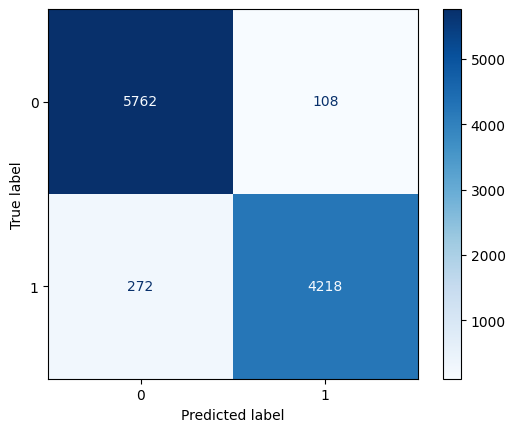

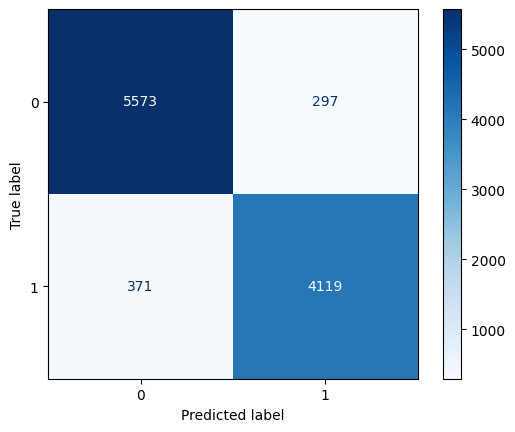

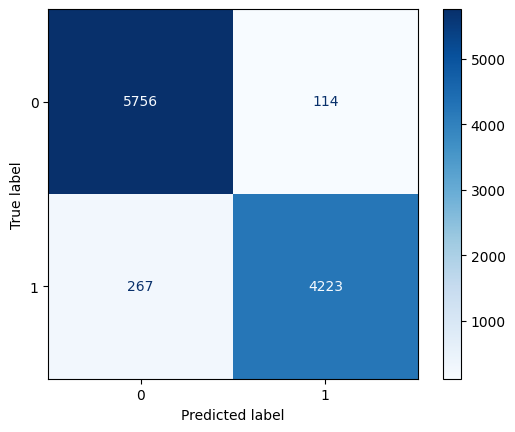

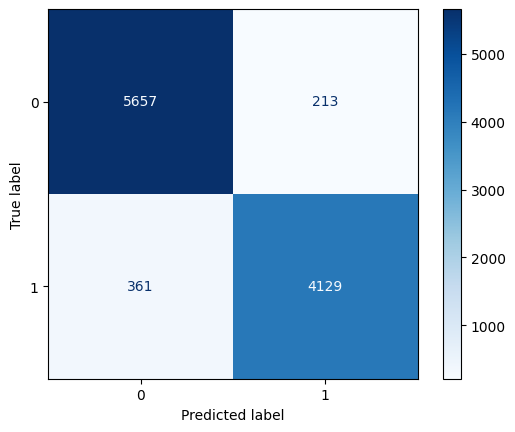

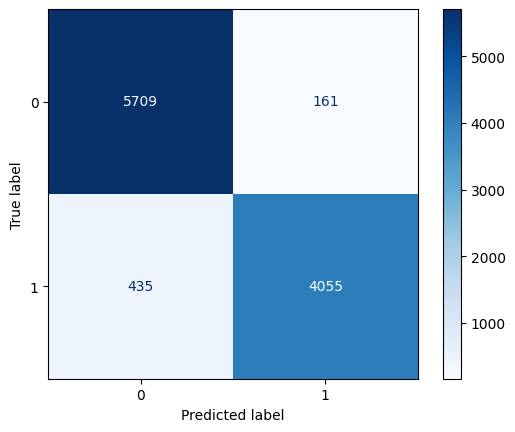

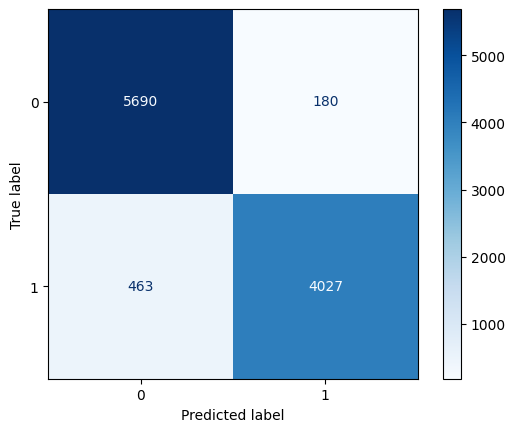

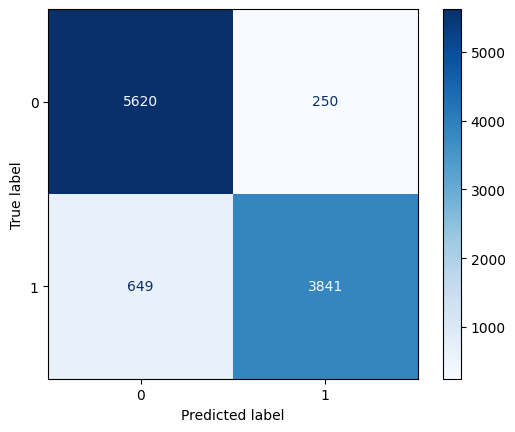

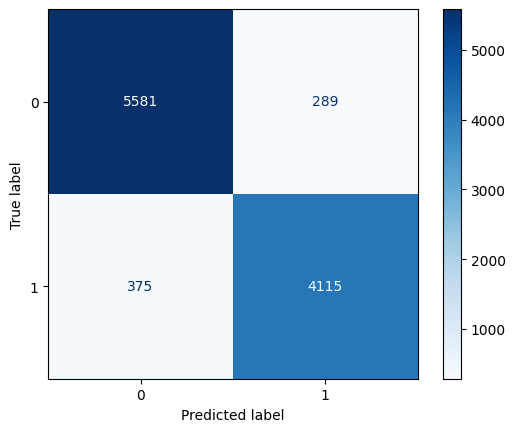

In [279]:
Values = Models(RandomForestClassifier(max_depth=40),X_train,y_train,X_test,y_test)

In [280]:
df = pd.DataFrame(Values,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Forest','Forest With Feature','Forest Scaling','Forest With Normalize','Forest With PCA','Forest With PCA and Scaling',
                'Forest With PCA and Normalize','Forest With Feature and Poly and Scaling']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Forest,1.000000,0.963320,0.956897,0.939421,0.975035,0.960511
Forest With Feature,0.934820,0.935521,0.924994,0.917372,0.932745,0.933388
Forest Scaling,1.000000,0.963224,0.956837,0.940535,0.973715,0.960557
Forest With Normalize,1.000000,0.944595,0.935009,0.919599,0.950944,0.941656
Forest With PCA,1.000000,0.942471,0.931541,0.903118,0.961812,0.937845
Forest With PCA and Scaling,0.999989,0.937934,0.926066,0.896882,0.957214,0.933109
Forest With PCA and Normalize,0.999989,0.913224,0.895234,0.855457,0.938890,0.906434
Forest With Feature and Poly and Scaling,0.934798,0.935907,0.925343,0.916481,0.934378,0.933624


In [281]:
models_draw(df)

    DecisionTreeClassifier

In [282]:
Search(DecisionTreeClassifier(max_depth=20),{'max_depth':[5,10,15,20,25,30,35,40]},X_train,y_train)

DecisionTreeClassifier(max_depth=15)

In [283]:
cross_validation(DecisionTreeClassifier(max_depth=15),X_train,y_train)

Train Score Value :  [0.97531741 0.97616207 0.97567941 0.97608162 0.97533115] 	 Mean 0.9757143327090446
Test Score Value :  [0.95291468 0.95087682 0.95076956 0.95119858 0.9512496 ] 	 Mean 0.9514018474778545


Apply Model With Normal Data : 

Model Train Score is :  0.973196473389536
Model Test Score is :  0.9522200772200772
F1 Score is :  0.943922057324119
Recall Score is :  0.9278396436525612
Precision Score is :  0.960571823841365
AUC Value  :  0.9493542340920387



Classification Report is :                precision    recall  f1-score   support

           0       0.95      0.97      0.96      5870
           1       0.96      0.93      0.94      4490

    accuracy                           0.95     10360
   macro avg       0.95      0.95      0.95     10360
weighted avg       0.95      0.95      0.95     10360


Confusion Matrix is : 
 [[5699  171]
 [ 324 4166]]


 Apply Model With Feature Selection :

Model Train Score is :  0.9263787888538516
Model Test Score is :  0.9301158301158301
F1 Score is :  0.9178206583427923
Recall Score is :  0.9004454342984409
Precision Score is :  0.9358796296296297
AUC Value  :  0.9266281685972613



Classification Report is :                precision    recall  f1-score   support

           0       0.93      0.95      0.94      5870
           1       0.94      0.90      0.92      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.93      0.93     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5593  277]
 [ 447 4043]]


 Apply Model With Normal Data With Scaling :

Model Train Score is :  0.9731321191839887
Model Test Score is :  0.9512548262548263
F1 Score is :  0.9428021293464719
Recall Score is :  0.9269487750556793
Precision Score is :  0.9592071905969117
AUC Value  :  0.9483977265397647



Classification Report is :                precision    recall  f1-score   support

           0       0.95      0.97      0.96      5870
           1       0.96      0.93      0.94      4490

    accuracy                           0.95     10360
   macro avg       0.95      0.95      0.95     10360
weighted avg       0.95      0.95      0.95     10360


Confusion Matrix is : 
 [[5693  177]
 [ 328 4162]]


 Apply Model With Normal Data With Normalize :

Model Train Score is :  0.9537936804170153
Model Test Score is :  0.9146718146718147
F1 Score is :  0.9025358324145535
Recall Score is :  0.9115812917594655
Precision Score is :  0.8936681222707423
AUC Value  :  0.914308533443617



Classification Report is :                precision    recall  f1-score   support

           0       0.93      0.92      0.92      5870
           1       0.89      0.91      0.90      4490

    accuracy                           0.91     10360
   macro avg       0.91      0.91      0.91     10360
weighted avg       0.91      0.91      0.91     10360


Confusion Matrix is : 
 [[5383  487]
 [ 397 4093]]


 Apply Model With Normal Data With PCA :

Model Train Score is :  0.9648518780702319
Model Test Score is :  0.9133204633204633
F1 Score is :  0.898093508851566
Recall Score is :  0.8812917594654789
Precision Score is :  0.9155483572420176
AUC Value  :  0.9095555901245623



Classification Report is :                precision    recall  f1-score   support

           0       0.91      0.94      0.92      5870
           1       0.92      0.88      0.90      4490

    accuracy                           0.91     10360
   macro avg       0.91      0.91      0.91     10360
weighted avg       0.91      0.91      0.91     10360


Confusion Matrix is : 
 [[5505  365]
 [ 533 3957]]


 Apply Model With Normal Data With PCA and Scaling :

Model Train Score is :  0.9687667589076946
Model Test Score is :  0.9094594594594595
F1 Score is :  0.8929223744292238
Recall Score is :  0.8710467706013363
Precision Score is :  0.9159250585480093
AUC Value  :  0.904944168946324



Classification Report is :                precision    recall  f1-score   support

           0       0.90      0.94      0.92      5870
           1       0.92      0.87      0.89      4490

    accuracy                           0.91     10360
   macro avg       0.91      0.90      0.91     10360
weighted avg       0.91      0.91      0.91     10360


Confusion Matrix is : 
 [[5511  359]
 [ 579 3911]]


 Apply Model With Normal Data With PCA and Normalize :

Model Train Score is :  0.9709977047000021
Model Test Score is :  0.8657335907335907
F1 Score is :  0.8443897527687659
Recall Score is :  0.8405345211581292
Precision Score is :  0.8482805124747134
AUC Value  :  0.8627715195228465



Classification Report is :                precision    recall  f1-score   support

           0       0.88      0.89      0.88      5870
           1       0.85      0.84      0.84      4490

    accuracy                           0.87     10360
   macro avg       0.86      0.86      0.86     10360
weighted avg       0.87      0.87      0.87     10360


Confusion Matrix is : 
 [[5195  675]
 [ 716 3774]]


 Apply Model With Normal Data With Feature Selection and Poly and Scaling :

Model Train Score is :  0.9263787888538516
Model Test Score is :  0.9301158301158301
F1 Score is :  0.9178019981834697
Recall Score is :  0.9002227171492205
Precision Score is :  0.936081519221862
AUC Value  :  0.9266019888982899



Classification Report is :                precision    recall  f1-score   support

           0       0.93      0.95      0.94      5870
           1       0.94      0.90      0.92      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.93      0.93     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5594  276]
 [ 448 4042]]


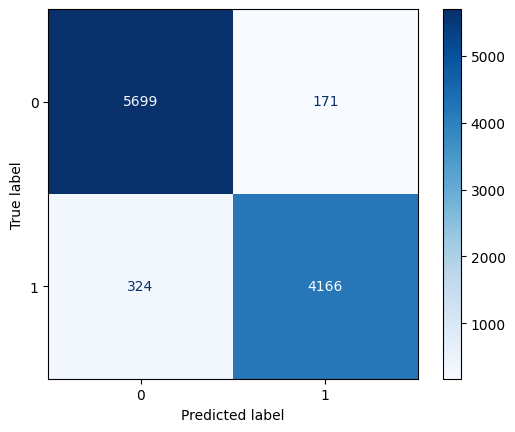

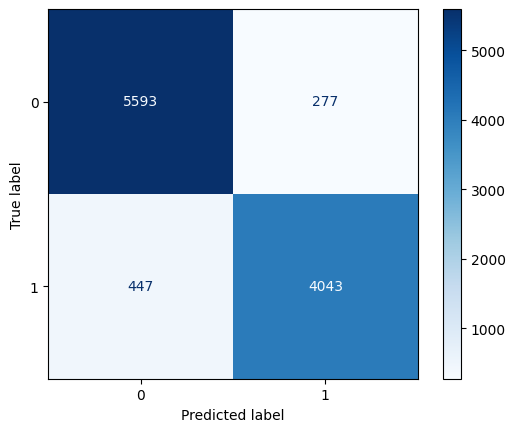

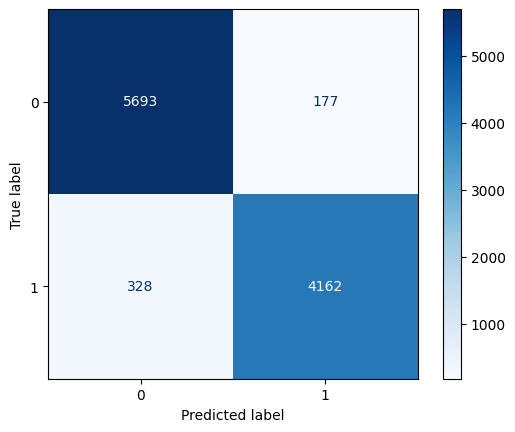

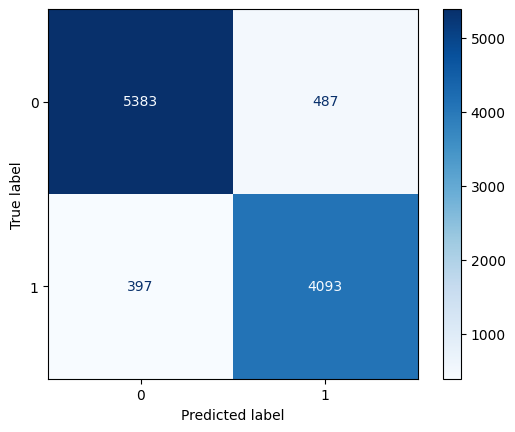

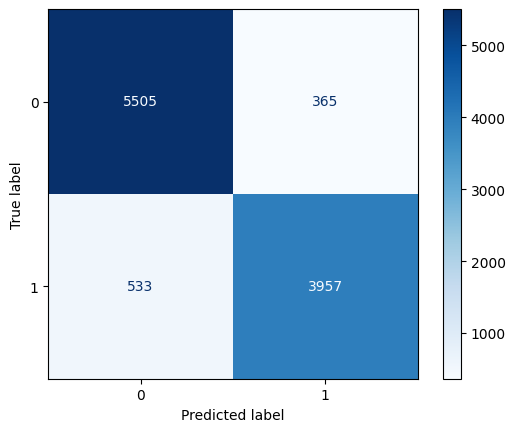

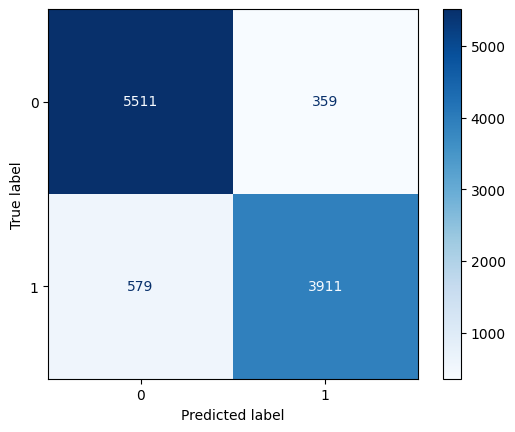

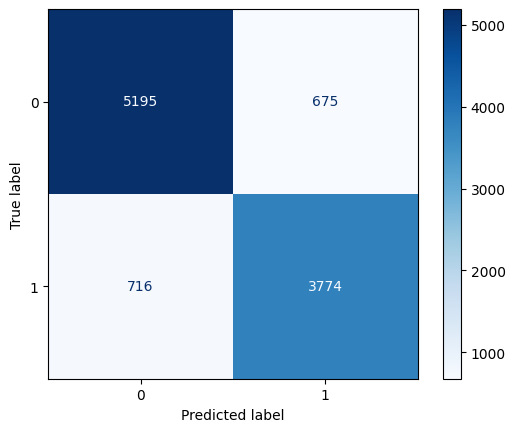

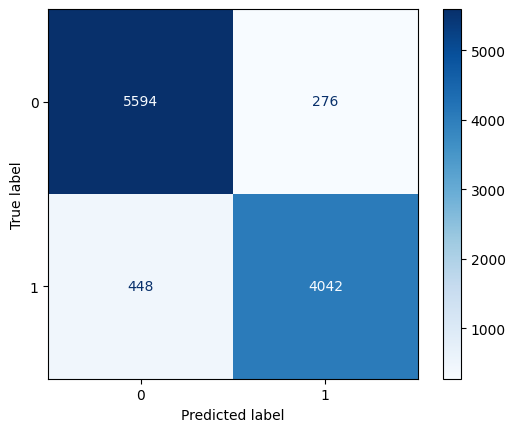

In [284]:
Values = Models(DecisionTreeClassifier(max_depth=15),X_train,y_train,X_test,y_test)

In [285]:
df = pd.DataFrame(Values,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Decision','Decision With Feature','Decision Scaling','Decision With Normalize','Decision With PCA','Decision With PCA and Scaling',
                'Decision With PCA and Normalize','Decision With Feature and Poly and Scaling']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Decision,0.973196,0.952220,0.943922,0.927840,0.960572,0.949354
Decision With Feature,0.926379,0.930116,0.917821,0.900445,0.935880,0.926628
Decision Scaling,0.973132,0.951255,0.942802,0.926949,0.959207,0.948398
Decision With Normalize,0.953794,0.914672,0.902536,0.911581,0.893668,0.914309
Decision With PCA,0.964852,0.913320,0.898094,0.881292,0.915548,0.909556
Decision With PCA and Scaling,0.968767,0.909459,0.892922,0.871047,0.915925,0.904944
Decision With PCA and Normalize,0.970998,0.865734,0.844390,0.840535,0.848281,0.862772
Decision With Feature and Poly and Scaling,0.926379,0.930116,0.917802,0.900223,0.936082,0.926602


In [286]:
models_draw(df)

    LogisticRegression

In [287]:
Search(LogisticRegression(penalty='l2',solver='sag',C=1.0),{'C':[1,.5,2,3,5,10,15,20]},X_train,y_train)

LogisticRegression(C=1, solver='sag')

In [288]:
cross_validation(LogisticRegression(penalty='l2',solver='sag',C=15),X_train,y_train)

Train Score Value :  [0.77411613 0.77390162 0.77451835 0.77415635 0.77517831] 	 Mean 0.7743741531947581
Test Score Value :  [0.77454818 0.77701507 0.77395828 0.77347563 0.77147914] 	 Mean 0.7740952590672775


Apply Model With Normal Data : 

Model Train Score is :  0.7848209880515692
Model Test Score is :  0.7812741312741313
F1 Score is :  0.7499448245420437
Recall Score is :  0.7567928730512249
Precision Score is :  0.7432195975503062
AUC Value  :  0.7783964365256125



Classification Report is :                precision    recall  f1-score   support

           0       0.81      0.80      0.81      5870
           1       0.74      0.76      0.75      4490

    accuracy                           0.78     10360
   macro avg       0.78      0.78      0.78     10360
weighted avg       0.78      0.78      0.78     10360


Confusion Matrix is : 
 [[4696 1174]
 [1092 3398]]


 Apply Model With Feature Selection :

Model Train Score is :  0.8365510436107
Model Test Score is :  0.8397683397683398
F1 Score is :  0.8139013452914798
Recall Score is :  0.8084632516703786
Precision Score is :  0.8194130925507901
AUC Value  :  0.8360885253241159



Classification Report is :                precision    recall  f1-score   support

           0       0.85      0.86      0.86      5870
           1       0.82      0.81      0.81      4490

    accuracy                           0.84     10360
   macro avg       0.84      0.84      0.84     10360
weighted avg       0.84      0.84      0.84     10360


Confusion Matrix is : 
 [[5070  800]
 [ 860 3630]]


 Apply Model With Normal Data With Scaling :

Model Train Score is :  0.8747023617993436
Model Test Score is :  0.8814671814671815
F1 Score is :  0.8603910868576625
Recall Score is :  0.8427616926503341
Precision Score is :  0.8787738039944264
AUC Value  :  0.8769174732416917



Classification Report is :                precision    recall  f1-score   support

           0       0.88      0.91      0.90      5870
           1       0.88      0.84      0.86      4490

    accuracy                           0.88     10360
   macro avg       0.88      0.88      0.88     10360
weighted avg       0.88      0.88      0.88     10360


Confusion Matrix is : 
 [[5348  522]
 [ 706 3784]]


 Apply Model With Normal Data With Normalize :

Model Train Score is :  0.8020893665401034
Model Test Score is :  0.8042471042471042
F1 Score is :  0.7706401266681746
Recall Score is :  0.7587973273942094
Precision Score is :  0.7828584558823529
AUC Value  :  0.7989046262183994



Classification Report is :                precision    recall  f1-score   support

           0       0.82      0.84      0.83      5870
           1       0.78      0.76      0.77      4490

    accuracy                           0.80     10360
   macro avg       0.80      0.80      0.80     10360
weighted avg       0.80      0.80      0.80     10360


Confusion Matrix is : 
 [[4925  945]
 [1083 3407]]


 Apply Model With Normal Data With PCA :

Model Train Score is :  0.8343415492202415
Model Test Score is :  0.8384169884169884
F1 Score is :  0.8153133274492497
Recall Score is :  0.8229398663697105
Precision Score is :  0.8078268473983384
AUC Value  :  0.8365977014983136



Classification Report is :                precision    recall  f1-score   support

           0       0.86      0.85      0.86      5870
           1       0.81      0.82      0.82      4490

    accuracy                           0.84     10360
   macro avg       0.84      0.84      0.84     10360
weighted avg       0.84      0.84      0.84     10360


Confusion Matrix is : 
 [[4991  879]
 [ 795 3695]]


 Apply Model With Normal Data With PCA and Scaling :

Model Train Score is :  0.874691636098419
Model Test Score is :  0.8815637065637065
F1 Score is :  0.8604889141557703
Recall Score is :  0.8427616926503341
Precision Score is :  0.8789779326364692
AUC Value  :  0.8770026521173305



Classification Report is :                precision    recall  f1-score   support

           0       0.88      0.91      0.90      5870
           1       0.88      0.84      0.86      4490

    accuracy                           0.88     10360
   macro avg       0.88      0.88      0.88     10360
weighted avg       0.88      0.88      0.88     10360


Confusion Matrix is : 
 [[5349  521]
 [ 706 3784]]


 Apply Model With Normal Data With PCA and Normalize :

Model Train Score is :  0.8020786408391788
Model Test Score is :  0.8042471042471042
F1 Score is :  0.7706401266681746
Recall Score is :  0.7587973273942094
Precision Score is :  0.7828584558823529
AUC Value  :  0.7989046262183994



Classification Report is :                precision    recall  f1-score   support

           0       0.82      0.84      0.83      5870
           1       0.78      0.76      0.77      4490

    accuracy                           0.80     10360
   macro avg       0.80      0.80      0.80     10360
weighted avg       0.80      0.80      0.80     10360


Confusion Matrix is : 
 [[4925  945]
 [1083 3407]]


 Apply Model With Normal Data With Feature Selection and Poly and Scaling :

Model Train Score is :  0.9060857627045927
Model Test Score is :  0.9074324324324324
F1 Score is :  0.8924526185936974
Recall Score is :  0.8861915367483296
Precision Score is :  0.8988028009939011
AUC Value  :  0.9049356320879638



Classification Report is :                precision    recall  f1-score   support

           0       0.91      0.92      0.92      5870
           1       0.90      0.89      0.89      4490

    accuracy                           0.91     10360
   macro avg       0.91      0.90      0.91     10360
weighted avg       0.91      0.91      0.91     10360


Confusion Matrix is : 
 [[5422  448]
 [ 511 3979]]


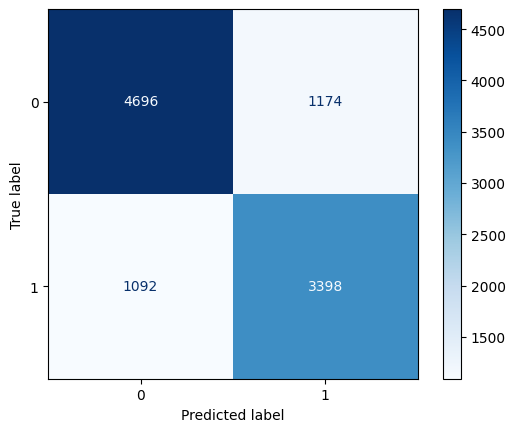

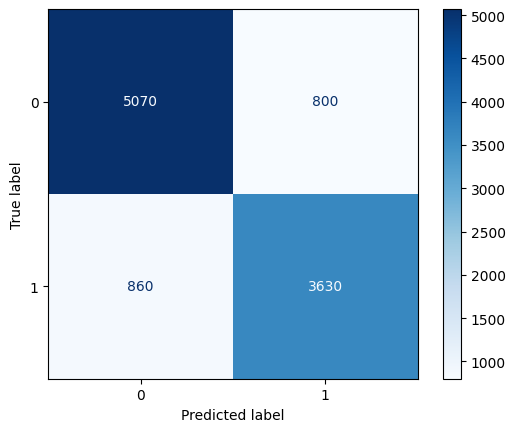

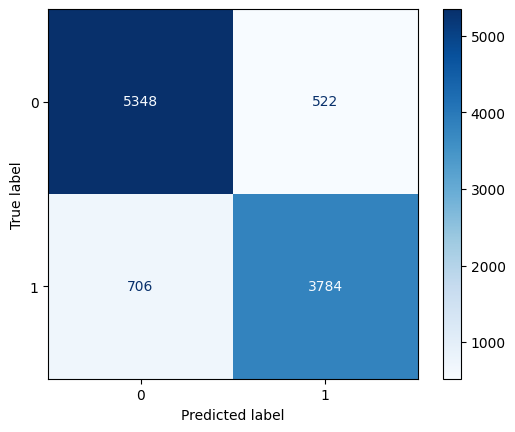

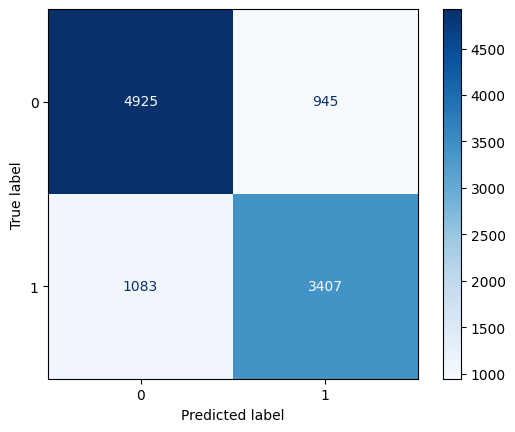

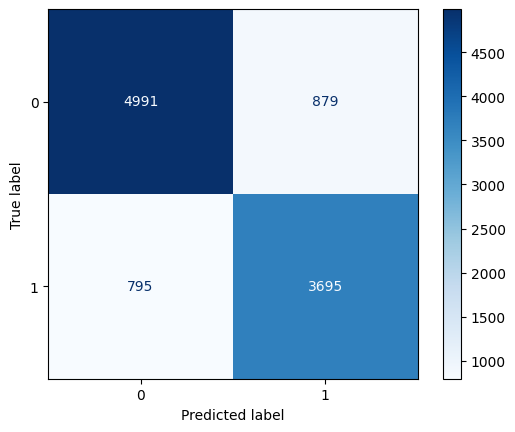

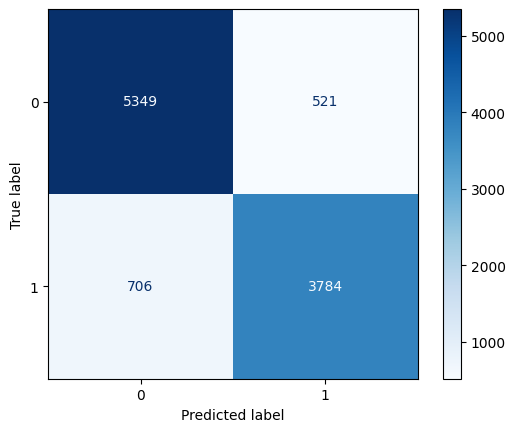

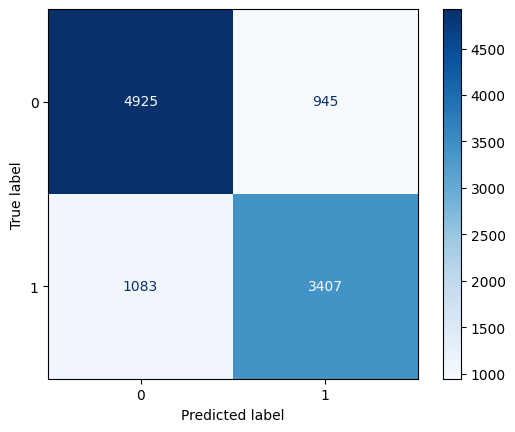

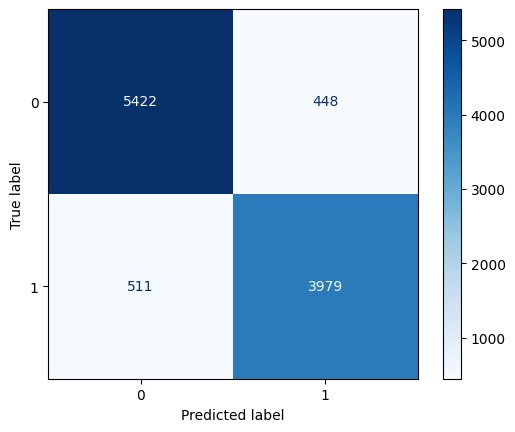

In [289]:
Values = Models(LogisticRegression(penalty='l2',solver='sag',C=15),X_train,y_train,X_test,y_test)

In [290]:
df = pd.DataFrame(Values,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Logistic','Logistic With Feature','Logistic Scaling','Logistic With Normalize','Logistic With PCA','Logistic With PCA and Scaling',
                'Logistic With PCA and Normalize','Logistic With Feature and Poly and Scaling']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Logistic,0.784821,0.781274,0.749945,0.756793,0.743220,0.778396
Logistic With Feature,0.836551,0.839768,0.813901,0.808463,0.819413,0.836089
Logistic Scaling,0.874702,0.881467,0.860391,0.842762,0.878774,0.876917
Logistic With Normalize,0.802089,0.804247,0.770640,0.758797,0.782858,0.798905
Logistic With PCA,0.834342,0.838417,0.815313,0.822940,0.807827,0.836598
Logistic With PCA and Scaling,0.874692,0.881564,0.860489,0.842762,0.878978,0.877003
Logistic With PCA and Normalize,0.802079,0.804247,0.770640,0.758797,0.782858,0.798905
Logistic With Feature and Poly and Scaling,0.906086,0.907432,0.892453,0.886192,0.898803,0.904936


In [291]:
models_draw(df)

    SVC

In [292]:
Search(SVC(kernel= 'rbf',max_iter=1000,C=1.0,gamma='auto'),{'C':[1,.5,2,3,5,10,15,20]},X_train,y_train) 

SVC(C=0.5, gamma='auto', max_iter=1000)

In [293]:
cross_validation(SVC(kernel= 'rbf',max_iter=1000,C=.5,gamma='auto'),X_train,y_train)

Train Score Value :  [0.48466891 0.49088983 0.5973427  0.59557296 0.59124792] 	 Mean 0.5519444641883386
Test Score Value :  [0.47085322 0.47557248 0.58261383 0.58320373 0.5734742 ] 	 Mean 0.5371434919740825


Apply Model With Normal Data : 

Model Train Score is :  0.48230259347448357
Model Test Score is :  0.47355212355212356
F1 Score is :  0.6185480486781367
Recall Score is :  0.9848552338530067
Precision Score is :  0.45085644371941275
AUC Value  :  0.5336541927357026



Classification Report is :                precision    recall  f1-score   support

           0       0.88      0.08      0.15      5870
           1       0.45      0.98      0.62      4490

    accuracy                           0.47     10360
   macro avg       0.66      0.53      0.38     10360
weighted avg       0.69      0.47      0.35     10360


Confusion Matrix is : 
 [[ 484 5386]
 [  68 4422]]


 Apply Model With Feature Selection :

Model Train Score is :  0.48079026964412125
Model Test Score is :  0.4811776061776062
F1 Score is :  0.6188754165780331
Recall Score is :  0.9719376391982183
Precision Score is :  0.4539685842088838
AUC Value  :  0.5388649013708298



Classification Report is :                precision    recall  f1-score   support

           0       0.83      0.11      0.19      5870
           1       0.45      0.97      0.62      4490

    accuracy                           0.48     10360
   macro avg       0.64      0.54      0.40     10360
weighted avg       0.67      0.48      0.37     10360


Confusion Matrix is : 
 [[ 621 5249]
 [ 126 4364]]


 Apply Model With Normal Data With Scaling :

Model Train Score is :  0.5699851985327241
Model Test Score is :  0.5658301158301158
F1 Score is :  0.6471049741095246
Recall Score is :  0.9184855233853007
Precision Score is :  0.499515503875969
AUC Value  :  0.607283647552957



Classification Report is :                precision    recall  f1-score   support

           0       0.83      0.30      0.44      5870
           1       0.50      0.92      0.65      4490

    accuracy                           0.57     10360
   macro avg       0.66      0.61      0.54     10360
weighted avg       0.68      0.57      0.53     10360


Confusion Matrix is : 
 [[1738 4132]
 [ 366 4124]]


 Apply Model With Normal Data With Normalize :

Model Train Score is :  0.43376879679087027
Model Test Score is :  0.4335907335907336
F1 Score is :  0.6047420180520006
Recall Score is :  0.9997772828507795
Precision Score is :  0.43346852066434916
AUC Value  :  0.5001441780523063



Classification Report is :                precision    recall  f1-score   support

           0       0.75      0.00      0.00      5870
           1       0.43      1.00      0.60      4490

    accuracy                           0.43     10360
   macro avg       0.59      0.50      0.30     10360
weighted avg       0.61      0.43      0.26     10360


Confusion Matrix is : 
 [[   3 5867]
 [   1 4489]]


 Apply Model With Normal Data With PCA :

Model Train Score is :  0.48230259347448357
Model Test Score is :  0.47355212355212356
F1 Score is :  0.6185480486781367
Recall Score is :  0.9848552338530067
Precision Score is :  0.45085644371941275
AUC Value  :  0.5336541927357026



Classification Report is :                precision    recall  f1-score   support

           0       0.88      0.08      0.15      5870
           1       0.45      0.98      0.62      4490

    accuracy                           0.47     10360
   macro avg       0.66      0.53      0.38     10360
weighted avg       0.69      0.47      0.35     10360


Confusion Matrix is : 
 [[ 484 5386]
 [  68 4422]]


 Apply Model With Normal Data With PCA and Scaling :

Model Train Score is :  0.5699851985327241
Model Test Score is :  0.5658301158301158
F1 Score is :  0.6471049741095246
Recall Score is :  0.9184855233853007
Precision Score is :  0.499515503875969
AUC Value  :  0.607283647552957



Classification Report is :                precision    recall  f1-score   support

           0       0.83      0.30      0.44      5870
           1       0.50      0.92      0.65      4490

    accuracy                           0.57     10360
   macro avg       0.66      0.61      0.54     10360
weighted avg       0.68      0.57      0.53     10360


Confusion Matrix is : 
 [[1738 4132]
 [ 366 4124]]


 Apply Model With Normal Data With PCA and Normalize :

Model Train Score is :  0.43376879679087027
Model Test Score is :  0.4335907335907336
F1 Score is :  0.6047420180520006
Recall Score is :  0.9997772828507795
Precision Score is :  0.43346852066434916
AUC Value  :  0.5001441780523063



Classification Report is :                precision    recall  f1-score   support

           0       0.75      0.00      0.00      5870
           1       0.43      1.00      0.60      4490

    accuracy                           0.43     10360
   macro avg       0.59      0.50      0.30     10360
weighted avg       0.61      0.43      0.26     10360


Confusion Matrix is : 
 [[   3 5867]
 [   1 4489]]


 Apply Model With Normal Data With Feature Selection and Poly and Scaling :

Model Train Score is :  0.5944183452388614
Model Test Score is :  0.5943050193050193
F1 Score is :  0.6544438049823235
Recall Score is :  0.8864142538975501
Precision Score is :  0.518701941874104
AUC Value  :  0.6286415392145331



Classification Report is :                precision    recall  f1-score   support

           0       0.81      0.37      0.51      5870
           1       0.52      0.89      0.65      4490

    accuracy                           0.59     10360
   macro avg       0.66      0.63      0.58     10360
weighted avg       0.68      0.59      0.57     10360


Confusion Matrix is : 
 [[2177 3693]
 [ 510 3980]]


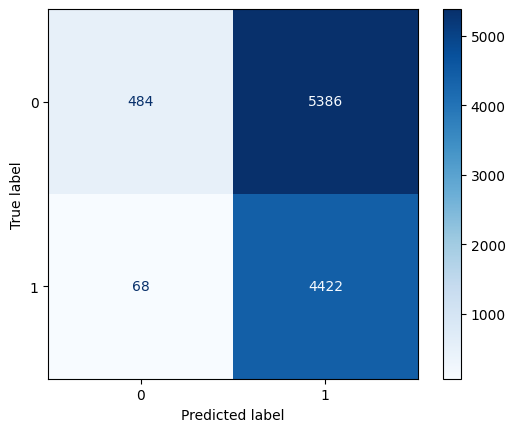

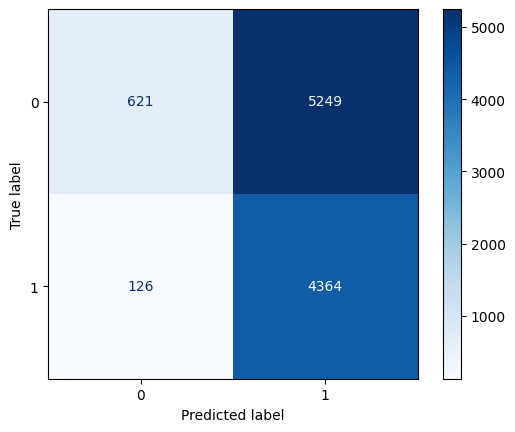

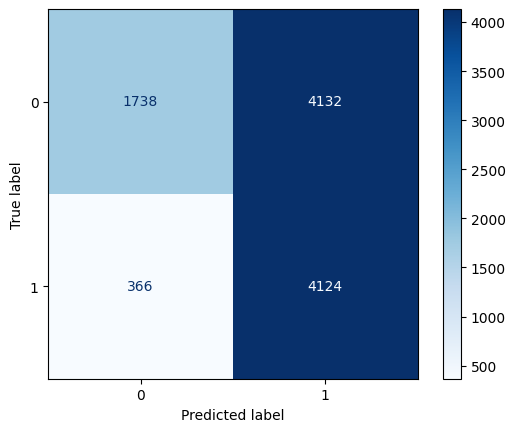

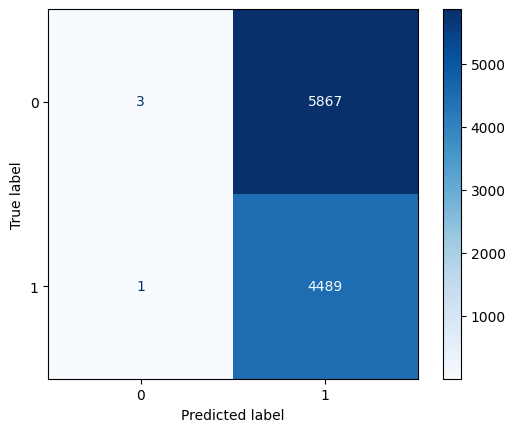

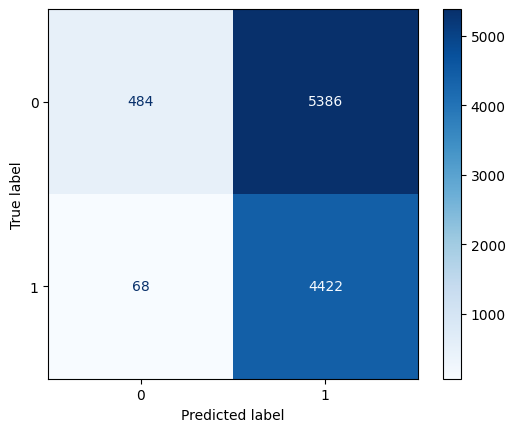

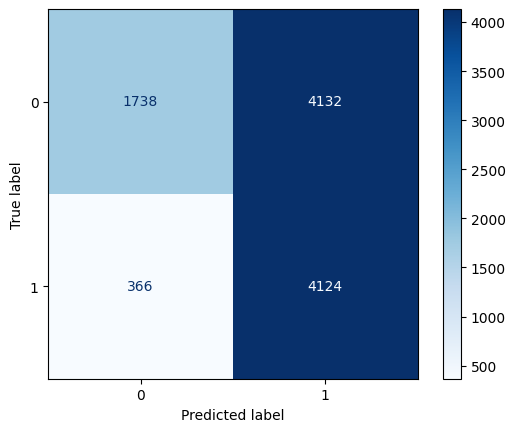

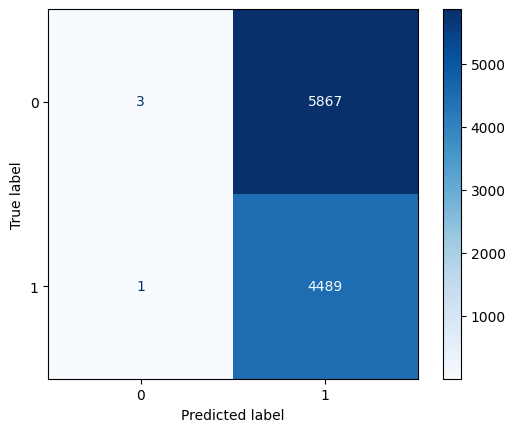

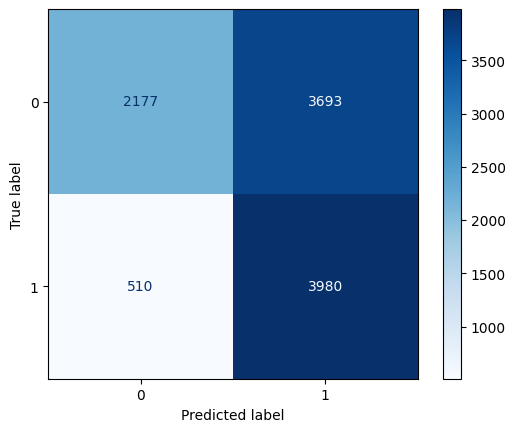

In [294]:
Values = Models(SVC(kernel= 'rbf',max_iter=1000,C=.5,gamma='auto'),X_train,y_train,X_test,y_test)

In [295]:
df = pd.DataFrame(Values,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['SVC','SVC With Feature','SVC Scaling','SVC With Normalize','SVC With PCA','SVC With PCA and Scaling',
                'SVC With PCA and Normalize','SVC With Feature and Poly and Scaling']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
SVC,0.482303,0.473552,0.618548,0.984855,0.450856,0.533654
SVC With Feature,0.480790,0.481178,0.618875,0.971938,0.453969,0.538865
SVC Scaling,0.569985,0.565830,0.647105,0.918486,0.499516,0.607284
SVC With Normalize,0.433769,0.433591,0.604742,0.999777,0.433469,0.500144
SVC With PCA,0.482303,0.473552,0.618548,0.984855,0.450856,0.533654
SVC With PCA and Scaling,0.569985,0.565830,0.647105,0.918486,0.499516,0.607284
SVC With PCA and Normalize,0.433769,0.433591,0.604742,0.999777,0.433469,0.500144
SVC With Feature and Poly and Scaling,0.594418,0.594305,0.654444,0.886414,0.518702,0.628642


In [296]:
models_draw(df)

    KNeighborsClassifier

In [297]:
Search(KNeighborsClassifier(n_neighbors=3),{'n_neighbors':[3,5,7,9,11]},X_train,y_train)

KNeighborsClassifier()

In [298]:
cross_validation(KNeighborsClassifier(n_neighbors=11),X_train,y_train)

Train Score Value :  [0.79496427 0.7961441  0.79478998 0.7953933  0.79692444] 	 Mean 0.7956432168489462
Test Score Value :  [0.75309701 0.74928943 0.75277525 0.75164906 0.74627266] 	 Mean 0.7506166812104791


Apply Model With Normal Data : 

Model Train Score is :  0.802121543642877
Model Test Score is :  0.7637065637065638
F1 Score is :  0.7111845210004719
Recall Score is :  0.6712694877505568
Precision Score is :  0.7561465127947817
AUC Value  :  0.7528408767543244



Classification Report is :                precision    recall  f1-score   support

           0       0.77      0.83      0.80      5870
           1       0.76      0.67      0.71      4490

    accuracy                           0.76     10360
   macro avg       0.76      0.75      0.76     10360
weighted avg       0.76      0.76      0.76     10360


Confusion Matrix is : 
 [[4898  972]
 [1476 3014]]


 Apply Model With Feature Selection :

Model Train Score is :  0.9247377566123947
Model Test Score is :  0.928088803088803
F1 Score is :  0.9154081980242987
Recall Score is :  0.897772828507795
Precision Score is :  0.9337502895529303
AUC Value  :  0.9245252558211888



Classification Report is :                precision    recall  f1-score   support

           0       0.92      0.95      0.94      5870
           1       0.93      0.90      0.92      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.92      0.93     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5584  286]
 [ 459 4031]]


 Apply Model With Normal Data With Scaling :

Model Train Score is :  0.9355814402471202
Model Test Score is :  0.9275096525096526
F1 Score is :  0.9126642632864287
Recall Score is :  0.8739420935412027
Precision Score is :  0.9549768800194695
AUC Value  :  0.9212129547774157



Classification Report is :                precision    recall  f1-score   support

           0       0.91      0.97      0.94      5870
           1       0.95      0.87      0.91      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.92      0.93     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5685  185]
 [ 566 3924]]


 Apply Model With Normal Data With Normalize :

Model Train Score is :  0.8419031683720531
Model Test Score is :  0.8142857142857143
F1 Score is :  0.7913684667100411
Recall Score is :  0.8126948775055679
Precision Score is :  0.7711327134404058
AUC Value  :  0.8140987164359185



Classification Report is :                precision    recall  f1-score   support

           0       0.85      0.82      0.83      5870
           1       0.77      0.81      0.79      4490

    accuracy                           0.81     10360
   macro avg       0.81      0.81      0.81     10360
weighted avg       0.82      0.81      0.81     10360


Confusion Matrix is : 
 [[4787 1083]
 [ 841 3649]]


 Apply Model With Normal Data With PCA :

Model Train Score is :  0.8019713838299333
Model Test Score is :  0.7637065637065638
F1 Score is :  0.7111845210004719
Recall Score is :  0.6712694877505568
Precision Score is :  0.7561465127947817
AUC Value  :  0.7528408767543244



Classification Report is :                precision    recall  f1-score   support

           0       0.77      0.83      0.80      5870
           1       0.76      0.67      0.71      4490

    accuracy                           0.76     10360
   macro avg       0.76      0.75      0.76     10360
weighted avg       0.76      0.76      0.76     10360


Confusion Matrix is : 
 [[4898  972]
 [1476 3014]]


 Apply Model With Normal Data With PCA and Scaling :

Model Train Score is :  0.9355814402471202
Model Test Score is :  0.9275096525096526
F1 Score is :  0.9126642632864287
Recall Score is :  0.8739420935412027
Precision Score is :  0.9549768800194695
AUC Value  :  0.9212129547774157



Classification Report is :                precision    recall  f1-score   support

           0       0.91      0.97      0.94      5870
           1       0.95      0.87      0.91      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.92      0.93     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5685  185]
 [ 566 3924]]


 Apply Model With Normal Data With PCA and Normalize :

Model Train Score is :  0.8419031683720531
Model Test Score is :  0.8142857142857143
F1 Score is :  0.7913684667100411
Recall Score is :  0.8126948775055679
Precision Score is :  0.7711327134404058
AUC Value  :  0.8140987164359185



Classification Report is :                precision    recall  f1-score   support

           0       0.85      0.82      0.83      5870
           1       0.77      0.81      0.79      4490

    accuracy                           0.81     10360
   macro avg       0.81      0.81      0.81     10360
weighted avg       0.82      0.81      0.81     10360


Confusion Matrix is : 
 [[4787 1083]
 [ 841 3649]]


 Apply Model With Normal Data With Feature Selection and Poly and Scaling :

Model Train Score is :  0.9235686552116181
Model Test Score is :  0.9263513513513514
F1 Score is :  0.9131671787868443
Recall Score is :  0.8935412026726058
Precision Score is :  0.9336746567372586
AUC Value  :  0.922494621779233



Classification Report is :                precision    recall  f1-score   support

           0       0.92      0.95      0.94      5870
           1       0.93      0.89      0.91      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.92      0.92     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5585  285]
 [ 478 4012]]


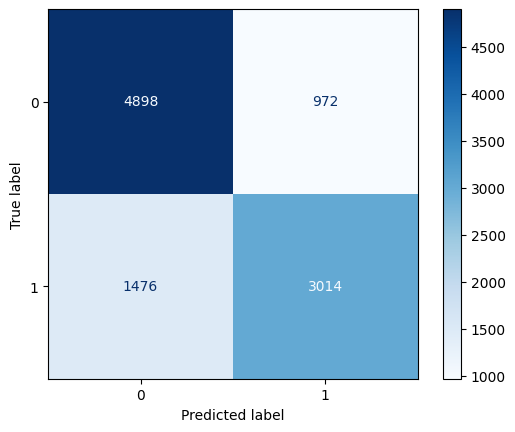

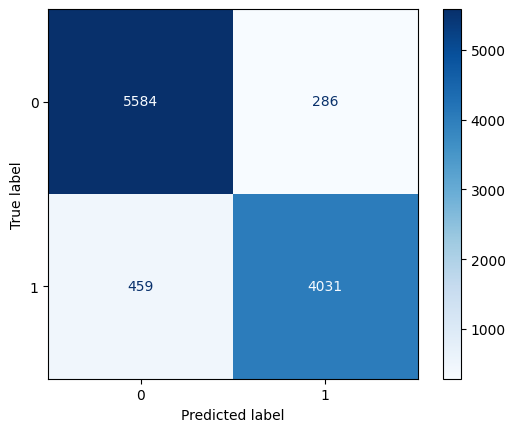

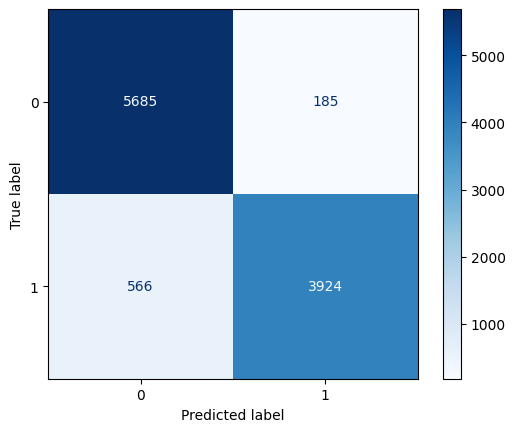

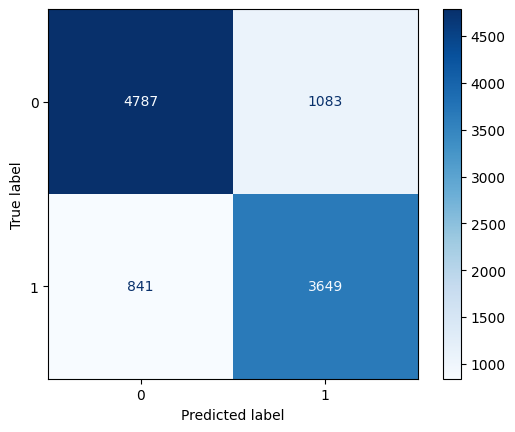

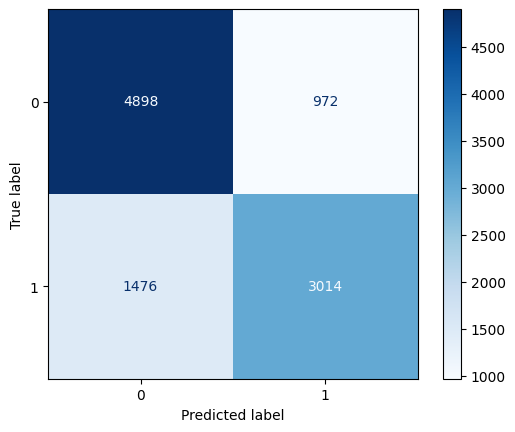

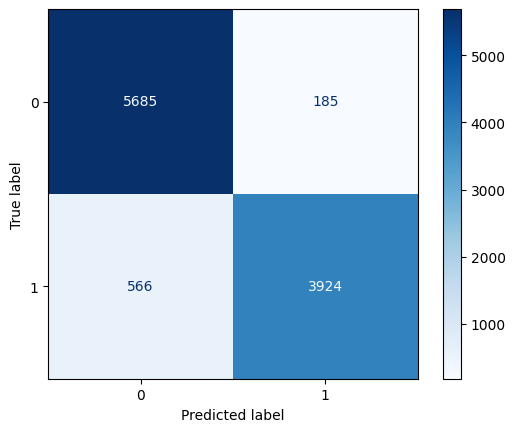

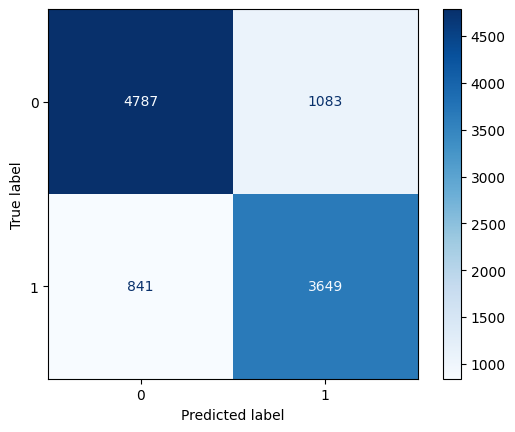

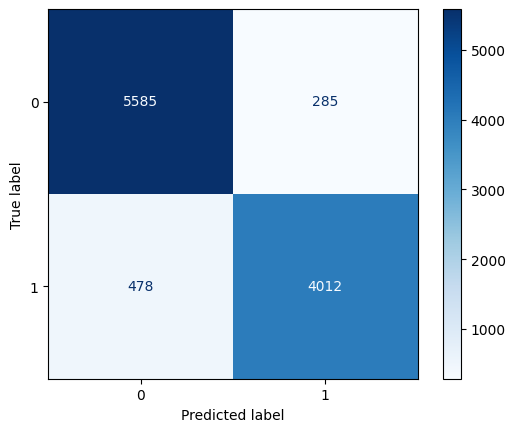

In [299]:
Values = Models(KNeighborsClassifier(n_neighbors=11),X_train,y_train,X_test,y_test)

In [300]:
df = pd.DataFrame(Values,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['KNN','KNN With Feature','KNN Scaling','KNN With Normalize','KNN With PCA','KNN With PCA and Scaling',
                'KNN With PCA and Normalize','KNN With Feature and Poly and Scaling']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
KNN,0.802122,0.763707,0.711185,0.671269,0.756147,0.752841
KNN With Feature,0.924738,0.928089,0.915408,0.897773,0.933750,0.924525
KNN Scaling,0.935581,0.927510,0.912664,0.873942,0.954977,0.921213
KNN With Normalize,0.841903,0.814286,0.791368,0.812695,0.771133,0.814099
KNN With PCA,0.801971,0.763707,0.711185,0.671269,0.756147,0.752841
KNN With PCA and Scaling,0.935581,0.927510,0.912664,0.873942,0.954977,0.921213
KNN With PCA and Normalize,0.841903,0.814286,0.791368,0.812695,0.771133,0.814099
KNN With Feature and Poly and Scaling,0.923569,0.926351,0.913167,0.893541,0.933675,0.922495


In [301]:
models_draw(df)

    GaussianNB

In [302]:
cross_validation(GaussianNB(),X_train,y_train)

Train Score Value :  [0.8672825  0.86738976 0.86698754 0.86663896 0.8675122 ] 	 Mean 0.8671621931108631
Test Score Value :  [0.86678822 0.86700274 0.86807529 0.86845069 0.8656012 ] 	 Mean 0.8671836284785899


Apply Model With Normal Data : 

Model Train Score is :  0.8671729197503056
Model Test Score is :  0.8696911196911197
F1 Score is :  0.8460310218978102
Recall Score is :  0.8260579064587973
Precision Score is :  0.8669939223936419
AUC Value  :  0.8645621729908978



Classification Report is :                precision    recall  f1-score   support

           0       0.87      0.90      0.89      5870
           1       0.87      0.83      0.85      4490

    accuracy                           0.87     10360
   macro avg       0.87      0.86      0.87     10360
weighted avg       0.87      0.87      0.87     10360


Confusion Matrix is : 
 [[5301  569]
 [ 781 3709]]


 Apply Model With Feature Selection :

Model Train Score is :  0.8408413239805221
Model Test Score is :  0.8444980694980695
F1 Score is :  0.8249103358330617
Recall Score is :  0.8452115812917594
Precision Score is :  0.8055614519210359
AUC Value  :  0.8445819405607009



Classification Report is :                precision    recall  f1-score   support

           0       0.88      0.84      0.86      5870
           1       0.81      0.85      0.82      4490

    accuracy                           0.84     10360
   macro avg       0.84      0.84      0.84     10360
weighted avg       0.85      0.84      0.84     10360


Confusion Matrix is : 
 [[4954  916]
 [ 695 3795]]


 Apply Model With Normal Data With Scaling :

Model Train Score is :  0.8673445309650986
Model Test Score is :  0.8696911196911197
F1 Score is :  0.845960748516659
Recall Score is :  0.8256124721603564
Precision Score is :  0.8673373888628919
AUC Value  :  0.8645098135929551



Classification Report is :                precision    recall  f1-score   support

           0       0.87      0.90      0.89      5870
           1       0.87      0.83      0.85      4490

    accuracy                           0.87     10360
   macro avg       0.87      0.86      0.87     10360
weighted avg       0.87      0.87      0.87     10360


Confusion Matrix is : 
 [[5303  567]
 [ 783 3707]]


 Apply Model With Normal Data With Normalize :

Model Train Score is :  0.6093914237295407
Model Test Score is :  0.6154440154440154
F1 Score is :  0.6603580562659846
Recall Score is :  0.8625835189309576
Precision Score is :  0.5349447513812154
AUC Value  :  0.6444944851894993



Classification Report is :                precision    recall  f1-score   support

           0       0.80      0.43      0.56      5870
           1       0.53      0.86      0.66      4490

    accuracy                           0.62     10360
   macro avg       0.67      0.64      0.61     10360
weighted avg       0.69      0.62      0.60     10360


Confusion Matrix is : 
 [[2503 3367]
 [ 617 3873]]


 Apply Model With Normal Data With PCA :

Model Train Score is :  0.8277666945534891
Model Test Score is :  0.8277992277992278
F1 Score is :  0.7935185185185185
Recall Score is :  0.7634743875278397
Precision Score is :  0.8260240963855422
AUC Value  :  0.8202380455526762



Classification Report is :                precision    recall  f1-score   support

           0       0.83      0.88      0.85      5870
           1       0.83      0.76      0.79      4490

    accuracy                           0.83     10360
   macro avg       0.83      0.82      0.82     10360
weighted avg       0.83      0.83      0.83     10360


Confusion Matrix is : 
 [[5148  722]
 [1062 3428]]


 Apply Model With Normal Data With PCA and Scaling :

Model Train Score is :  0.844488062294871
Model Test Score is :  0.8442084942084942
F1 Score is :  0.8154162854528819
Recall Score is :  0.7939866369710468
Precision Score is :  0.8380347907851434
AUC Value  :  0.8383050731703616



Classification Report is :                precision    recall  f1-score   support

           0       0.85      0.88      0.87      5870
           1       0.84      0.79      0.82      4490

    accuracy                           0.84     10360
   macro avg       0.84      0.84      0.84     10360
weighted avg       0.84      0.84      0.84     10360


Confusion Matrix is : 
 [[5181  689]
 [ 925 3565]]


 Apply Model With Normal Data With PCA and Normalize :

Model Train Score is :  0.5719587275028423
Model Test Score is :  0.5803088803088803
F1 Score is :  0.6423753906892582
Recall Score is :  0.8697104677060133
Precision Score is :  0.5092592592592593
AUC Value  :  0.6143271248240458



Classification Report is :                precision    recall  f1-score   support

           0       0.78      0.36      0.49      5870
           1       0.51      0.87      0.64      4490

    accuracy                           0.58     10360
   macro avg       0.65      0.61      0.57     10360
weighted avg       0.66      0.58      0.56     10360


Confusion Matrix is : 
 [[2107 3763]
 [ 585 3905]]


 Apply Model With Normal Data With Feature Selection and Poly and Scaling :

Model Train Score is :  0.8347491258553746
Model Test Score is :  0.8376447876447877
F1 Score is :  0.8220482437579347
Recall Score is :  0.8652561247216035
Precision Score is :  0.782950423216445
AUC Value  :  0.8408904132977693



Classification Report is :                precision    recall  f1-score   support

           0       0.89      0.82      0.85      5870
           1       0.78      0.87      0.82      4490

    accuracy                           0.84     10360
   macro avg       0.84      0.84      0.84     10360
weighted avg       0.84      0.84      0.84     10360


Confusion Matrix is : 
 [[4793 1077]
 [ 605 3885]]


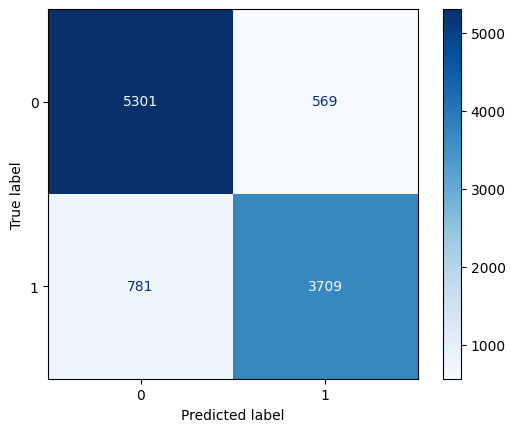

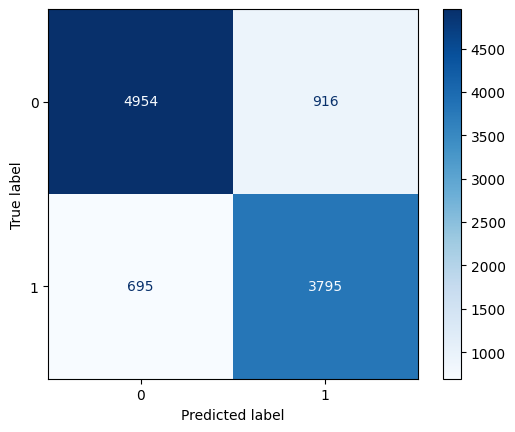

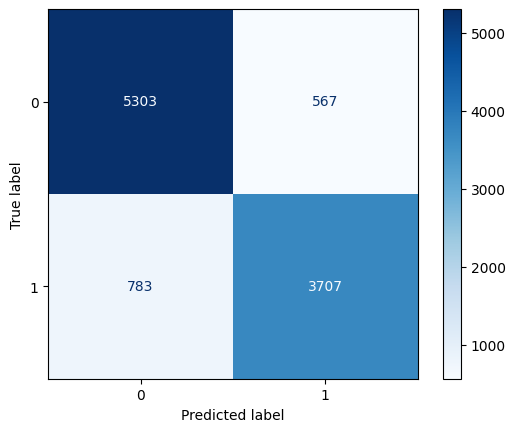

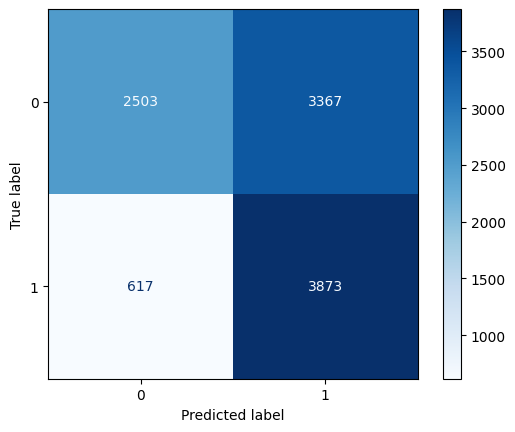

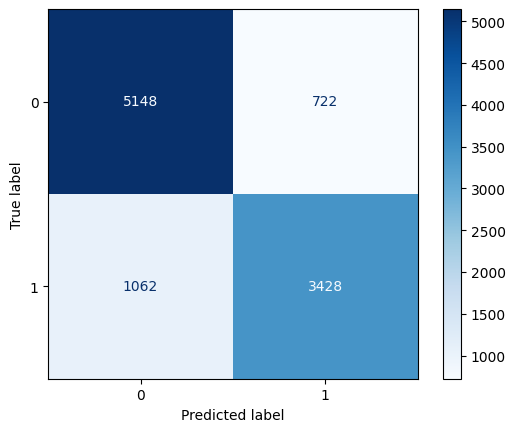

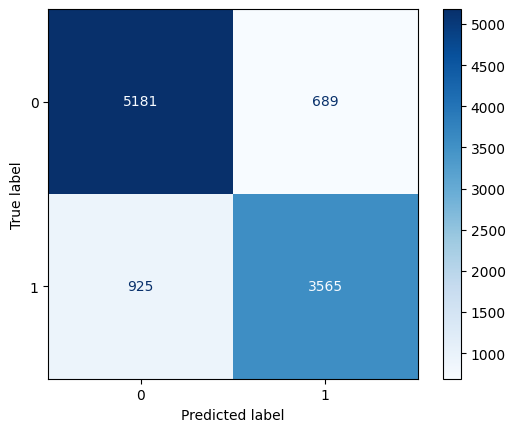

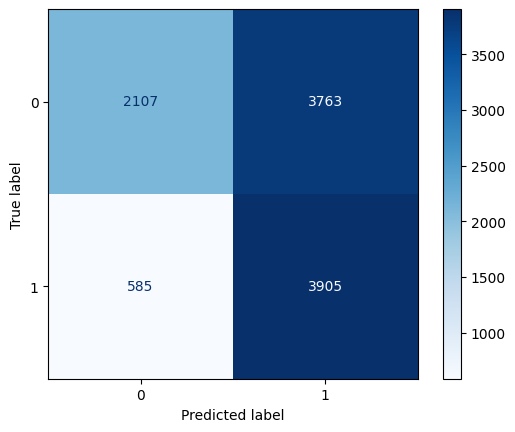

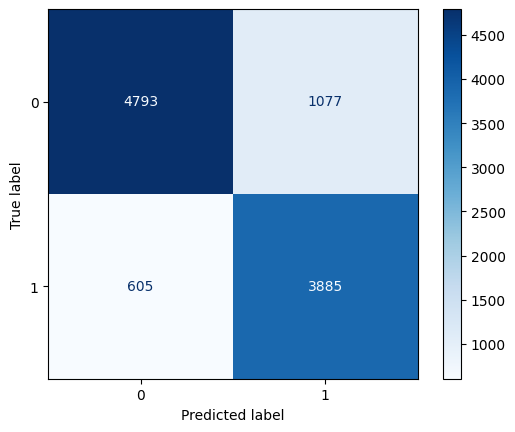

In [303]:
Values = Models(GaussianNB(),X_train,y_train,X_test,y_test)

In [304]:
df = pd.DataFrame(Values,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['NB','NB With Feature','NB Scaling','KNN With Normalize','NB With PCA','NB With PCA and Scaling',
                'NB With PCA and Normalize','NB With Feature and Poly and Scaling']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
NB,0.867173,0.869691,0.846031,0.826058,0.866994,0.864562
NB With Feature,0.840841,0.844498,0.824910,0.845212,0.805561,0.844582
NB Scaling,0.867345,0.869691,0.845961,0.825612,0.867337,0.864510
KNN With Normalize,0.609391,0.615444,0.660358,0.862584,0.534945,0.644494
NB With PCA,0.827767,0.827799,0.793519,0.763474,0.826024,0.820238
NB With PCA and Scaling,0.844488,0.844208,0.815416,0.793987,0.838035,0.838305
NB With PCA and Normalize,0.571959,0.580309,0.642375,0.869710,0.509259,0.614327
NB With Feature and Poly and Scaling,0.834749,0.837645,0.822048,0.865256,0.782950,0.840890


In [305]:
models_draw(df)

    GradientBoostingClassifier

In [306]:
Search(GradientBoostingClassifier(max_depth=3),{'max_depth':[5,10,15,20,25,30,35,40]},X_train,y_train)

GradientBoostingClassifier(max_depth=10)

In [307]:
cross_validation(GradientBoostingClassifier(max_depth=10),X_train,y_train)

Train Score Value :  [0.99501254 0.99568289 0.99671525 0.9953209  0.99514667] 	 Mean 0.995575649518891
Test Score Value :  [0.96213868 0.96187054 0.96256771 0.96224594 0.96428188] 	 Mean 0.9626209500925995


Apply Model With Normal Data : 

Model Train Score is :  0.992931763090718
Model Test Score is :  0.9640926640926641
F1 Score is :  0.9579470947320823
Recall Score is :  0.9436525612472161
Precision Score is :  0.9726813590449954
AUC Value  :  0.9616899944225858



Classification Report is :                precision    recall  f1-score   support

           0       0.96      0.98      0.97      5870
           1       0.97      0.94      0.96      4490

    accuracy                           0.96     10360
   macro avg       0.97      0.96      0.96     10360
weighted avg       0.96      0.96      0.96     10360


Confusion Matrix is : 
 [[5751  119]
 [ 253 4237]]


 Apply Model With Feature Selection :

Model Train Score is :  0.9263787888538516
Model Test Score is :  0.9302123552123552
F1 Score is :  0.9179434797412325
Recall Score is :  0.9006681514476614
Precision Score is :  0.935894468872946
AUC Value  :  0.9267395271718716



Classification Report is :                precision    recall  f1-score   support

           0       0.93      0.95      0.94      5870
           1       0.94      0.90      0.92      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.93      0.93     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5593  277]
 [ 446 4044]]


 Apply Model With Normal Data With Scaling :

Model Train Score is :  0.9925349121565095
Model Test Score is :  0.9640926640926641
F1 Score is :  0.9579661016949153
Recall Score is :  0.944097995545657
Precision Score is :  0.9722477064220183
AUC Value  :  0.9617423538205285



Classification Report is :                precision    recall  f1-score   support

           0       0.96      0.98      0.97      5870
           1       0.97      0.94      0.96      4490

    accuracy                           0.96     10360
   macro avg       0.97      0.96      0.96     10360
weighted avg       0.96      0.96      0.96     10360


Confusion Matrix is : 
 [[5749  121]
 [ 251 4239]]


 Apply Model With Normal Data With Normalize :

Model Train Score is :  0.9876118154321385
Model Test Score is :  0.9475868725868726
F1 Score is :  0.9391187352842246
Recall Score is :  0.9327394209354121
Precision Score is :  0.945585911040867
AUC Value  :  0.9458416014387453



Classification Report is :                precision    recall  f1-score   support

           0       0.95      0.96      0.95      5870
           1       0.95      0.93      0.94      4490

    accuracy                           0.95     10360
   macro avg       0.95      0.95      0.95     10360
weighted avg       0.95      0.95      0.95     10360


Confusion Matrix is : 
 [[5629  241]
 [ 302 4188]]


 Apply Model With Normal Data With PCA :

Model Train Score is :  0.994862389257138
Model Test Score is :  0.9488416988416989
F1 Score is :  0.9396355353075171
Recall Score is :  0.9187082405345212
Precision Score is :  0.9615384615384616
AUC Value  :  0.9452996057868518



Classification Report is :                precision    recall  f1-score   support

           0       0.94      0.97      0.96      5870
           1       0.96      0.92      0.94      4490

    accuracy                           0.95     10360
   macro avg       0.95      0.95      0.95     10360
weighted avg       0.95      0.95      0.95     10360


Confusion Matrix is : 
 [[5705  165]
 [ 365 4125]]


 Apply Model With Normal Data With PCA and Scaling :

Model Train Score is :  0.9925992663620568
Model Test Score is :  0.946911196911197
F1 Score is :  0.9375851112119837
Recall Score is :  0.9200445434298441
Precision Score is :  0.9558074965293846
AUC Value  :  0.9437531064679033



Classification Report is :                precision    recall  f1-score   support

           0       0.94      0.97      0.95      5870
           1       0.96      0.92      0.94      4490

    accuracy                           0.95     10360
   macro avg       0.95      0.94      0.95     10360
weighted avg       0.95      0.95      0.95     10360


Confusion Matrix is : 
 [[5679  191]
 [ 359 4131]]


 Apply Model With Normal Data With PCA and Normalize :

Model Train Score is :  0.9940043331831735
Model Test Score is :  0.9226833976833977
F1 Score is :  0.9086971389490482
Recall Score is :  0.8877505567928731
Precision Score is :  0.9306560821853841
AUC Value  :  0.9185771523317006



Classification Report is :                precision    recall  f1-score   support

           0       0.92      0.95      0.93      5870
           1       0.93      0.89      0.91      4490

    accuracy                           0.92     10360
   macro avg       0.92      0.92      0.92     10360
weighted avg       0.92      0.92      0.92     10360


Confusion Matrix is : 
 [[5573  297]
 [ 504 3986]]


 Apply Model With Normal Data With Feature Selection and Poly and Scaling :

Model Train Score is :  0.9263787888538516
Model Test Score is :  0.9298262548262548
F1 Score is :  0.9175456504479982
Recall Score is :  0.9008908685968819
Precision Score is :  0.934827825283106
AUC Value  :  0.9264249913682877



Classification Report is :                precision    recall  f1-score   support

           0       0.93      0.95      0.94      5870
           1       0.93      0.90      0.92      4490

    accuracy                           0.93     10360
   macro avg       0.93      0.93      0.93     10360
weighted avg       0.93      0.93      0.93     10360


Confusion Matrix is : 
 [[5588  282]
 [ 445 4045]]


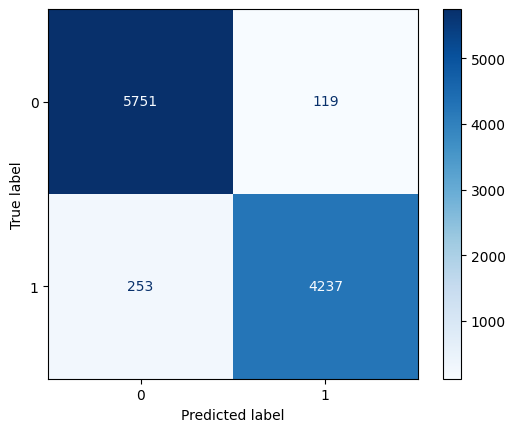

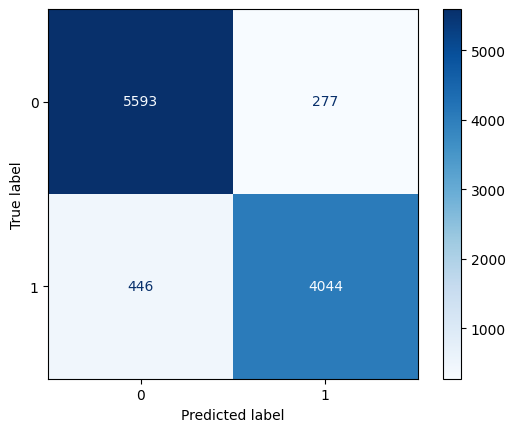

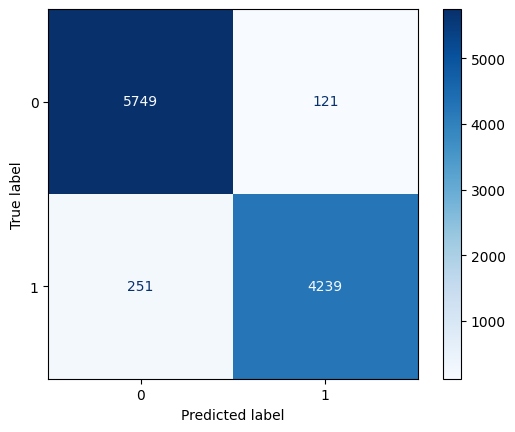

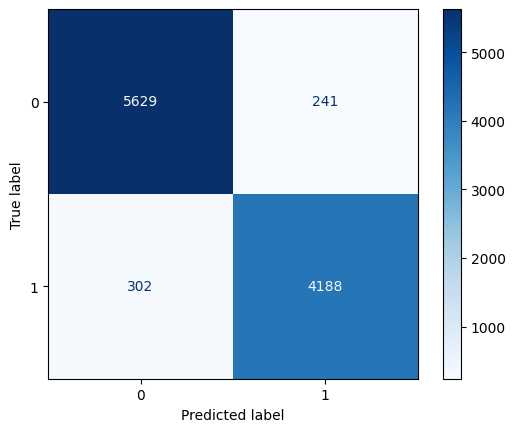

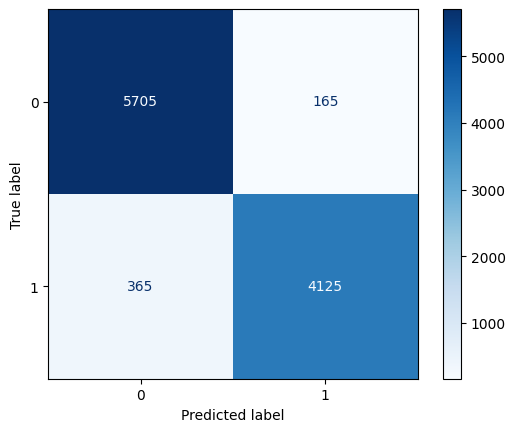

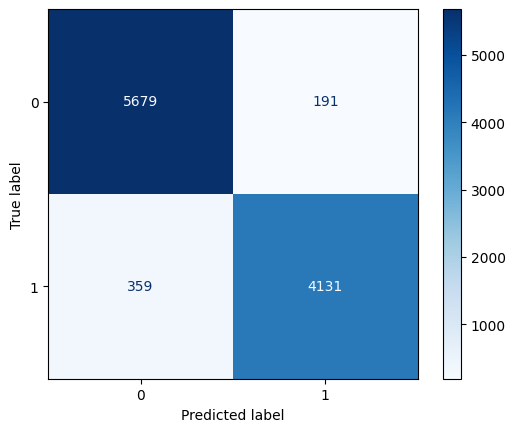

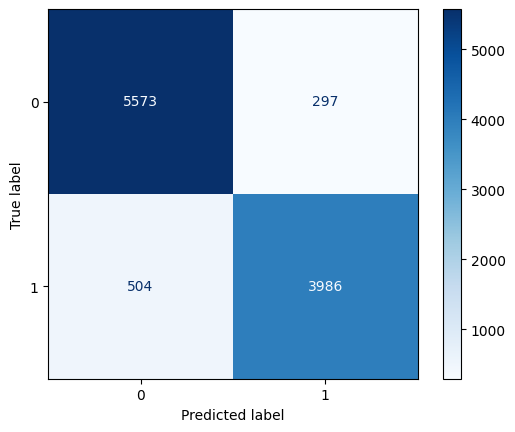

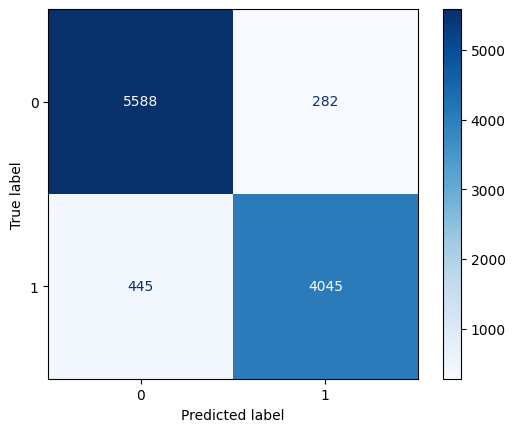

In [308]:
Values = Models(GradientBoostingClassifier(max_depth=10),X_train,y_train,X_test,y_test)

In [309]:
df = pd.DataFrame(Values,columns=['Train Accuracy','Test Accuracy','Test F1','Test Recall','Test Precision','AUC'])
df['Models'] = ['Gradient','Gradient With Feature','Gradient Scaling','Gradient With Normalize','Gradient With PCA','Gradient With PCA and Scaling',
                'Gradient With PCA and Normalize','Gradient With Feature and Poly and Scaling']
df.set_index('Models', inplace=True)
df

,Train Accuracy,Test Accuracy,Test F1,Test Recall,Test Precision,AUC
Models,,,,,,
Gradient,0.992932,0.964093,0.957947,0.943653,0.972681,0.961690
Gradient With Feature,0.926379,0.930212,0.917943,0.900668,0.935894,0.926740
Gradient Scaling,0.992535,0.964093,0.957966,0.944098,0.972248,0.961742
Gradient With Normalize,0.987612,0.947587,0.939119,0.932739,0.945586,0.945842
Gradient With PCA,0.994862,0.948842,0.939636,0.918708,0.961538,0.945300
Gradient With PCA and Scaling,0.992599,0.946911,0.937585,0.920045,0.955807,0.943753
Gradient With PCA and Normalize,0.994004,0.922683,0.908697,0.887751,0.930656,0.918577
Gradient With Feature and Poly and Scaling,0.926379,0.929826,0.917546,0.900891,0.934828,0.926425


In [310]:
models_draw(df)

**<a id="6"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">DL Models 🕵️‍♂️🕵️‍♂️</p>
<a class="btn" href="#home">Tabel of Contents</a>

In [311]:
X_train_c,y_train_c,X_test_c,y_test_c=Split(X_classification,y_classification)

X_train shape is  (93234, 22)
X_test shape is  (10360, 22)
y_train shape is  (93234,)
y_test shape is  (10360,)


In [312]:
classification_Input = keras.Input(shape=(X_classification.shape[1],))

dense_layer1 = keras.layers.Dense(128, activation='relu', name='Dense_Layer1')(classification_Input)
batch = keras.layers.BatchNormalization()(dense_layer1)
drop = keras.layers.Dropout(.2)(batch)
dense_layer2 = keras.layers.Dense(256, activation='relu', name='Dense_Layer2')(drop)
batch = keras.layers.BatchNormalization()(dense_layer2)
layer_C = keras.layers.Dense(1, activation='sigmoid', name='Dense_Layer3')(batch)

model = keras.Model(inputs=[classification_Input], outputs=[layer_C])

In [313]:
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 22)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dense_Layer1 (Dense)            │ (None, 128)            │         2,944 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dense_Layer2 (Dense)            │ (None, 256)            │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dense_Layer3 (Dense)            │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 37,761 (147.50 KB)

 Trainable params: 36,993 (144.50 KB)

 Non-trainable params: 768 (3.00 KB)

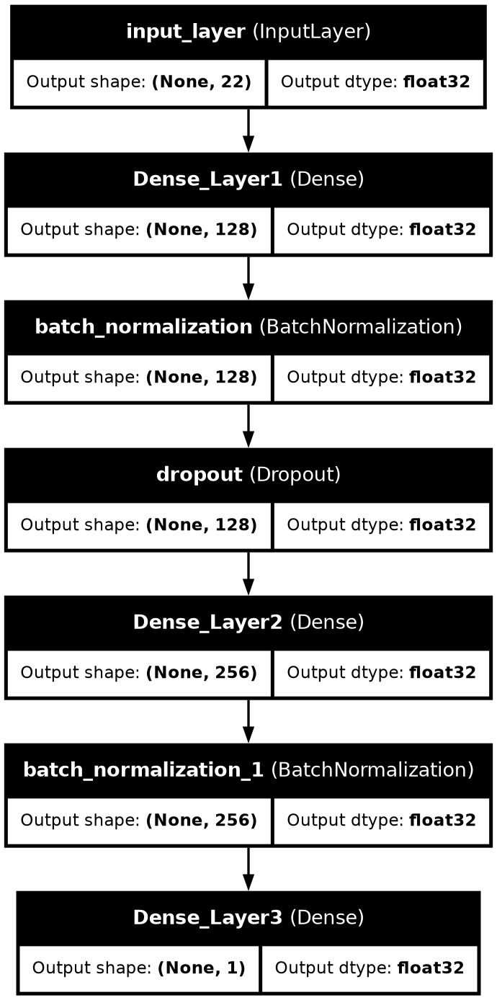

In [314]:
keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True,show_dtype=True,dpi=120)

In [315]:
model.compile(optimizer='adam', 
              loss={'Dense_Layer3': 'binary_crossentropy'}, 
              metrics={'Dense_Layer3': 'accuracy'})
checkpoint_cb = keras.callbacks.ModelCheckpoint("my_keras_model.keras", save_best_only=True)
early_stopping_cb = keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)
hist = model.fit(X_train_c,y_train_c, 
          epochs=50, 
          batch_size=32,validation_split=.1,
          callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.7784 - loss: 0.4769 - val_accuracy: 0.8225 - val_loss: 0.4617
Epoch 2/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.8604 - loss: 0.3454 - val_accuracy: 0.8886 - val_loss: 0.2620
Epoch 3/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.8754 - loss: 0.2977 - val_accuracy: 0.8871 - val_loss: 0.2660
Epoch 4/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.8853 - loss: 0.2742 - val_accuracy: 0.8705 - val_loss: 0.3019
Epoch 5/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.8913 - loss: 0.2633 - val_accuracy: 0.9044 - val_loss: 0.2236
Epoch 6/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.8974 - loss: 0.2479 - val_accuracy: 0.9027 - val_loss: 0.2256
Epoch 7/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.8959 - loss: 0.2489 - val_accuracy: 0.9026 - val_loss: 0.2315
Epoch 8/50
2623/2623 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9014 - loss: 0.2366

In [316]:
model.evaluate(X_test_c,y_test_c)

324/324 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9365 - loss: 0.1533


[0.15476644039154053, 0.9371621608734131]

In [317]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,loss,val_accuracy,val_loss
0,0.822965,0.411136,0.822501,0.461745
1,0.863604,0.332448,0.888567,0.262040
2,0.877655,0.293214,0.887066,0.265979
3,0.886390,0.270610,0.870549,0.301910
4,0.893052,0.257998,0.904440,0.223648
5,0.897271,0.248568,0.902724,0.225622
6,0.897271,0.246954,0.902617,0.231477
7,0.901359,0.237320,0.914200,0.201527
8,0.902908,0.235208,0.916238,0.202760
9,0.900608,0.236177,0.911519,0.216159


In [318]:
def summary_plot():
    fig = make_subplots(rows=1, cols=2, subplot_titles=("Total Loss","Classification Accuracy"))
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['loss'], mode='lines', name='Train Loss', line=dict(color='blue')), row=1, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['val_loss'], mode='lines', name='Validation Loss', line=dict(color='blue')), row=1, col=1)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['accuracy'], mode='lines', name='Train Accuracy', line=dict(color='red')), row=1, col=2)
    fig.add_trace(go.Scatter(x=hist_.index, y=hist_['val_accuracy'], mode='lines', name='Validation Accuracy', line=dict(color='red')), row=1, col=2)
    fig.update_layout(
        title_text="Training Summary",
        title_x=0.5,
        title_font=dict(size=20),
        font=dict(size=15),
        width=1100,
        height=600,
        template='plotly_dark'
    )
    fig.update_annotations(font=dict(size=20))
    fig.show()

In [319]:
summary_plot()

In [320]:
predictions = model.predict(X_test_c)

324/324 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


In [321]:
classification_predictions = np.where(predictions>=.5,1,0)

In [322]:
def Check():
    train = accuracy_score(y_train_c,np.where(model.predict(X_train_c)>=.5,1,0))
    y_pred=classification_predictions
    test = accuracy_score(y_test_c,y_pred)
    print('Model Train Score is : ' , train)
    print('Model Test Score is : ' , test)
    F1Score = f1_score(y_test_c, y_pred) 
    print('F1 Score is : ', F1Score)
    RecallScore = recall_score(y_test_c, y_pred) 
    print('Recall Score is : ', RecallScore)
    PrecisionScore = precision_score(y_test_c, y_pred)
    print('Precision Score is : ', PrecisionScore)
    fprValue2, tprValue2, thresholdsValue2 = roc_curve(y_test_c,y_pred)
    AUCValue = auc(fprValue2, tprValue2)
    print('AUC Value  : ', AUCValue)
    Area(fprValue2,tprValue2,AUCValue)
    ClassificationReport = classification_report(y_test_c,y_pred)
    print('Classification Report is : ', ClassificationReport)
    CM = confusion_matrix(y_test_c, y_pred)
    print('Confusion Matrix is : \n', CM)
    disp = ConfusionMatrixDisplay(confusion_matrix=CM, display_labels=[0,1])
    disp.plot(cmap='Blues')

2914/2914 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step
Model Train Score is :  0.9349057210888732
Model Test Score is :  0.9371621621621622
F1 Score is :  0.9236542746569718
Recall Score is :  0.8770601336302896
Precision Score is :  0.9754768392370572
AUC Value  :  0.9300973581268995


Classification Report is :                precision    recall  f1-score   support

           0       0.91      0.98      0.95      5870
           1       0.98      0.88      0.92      4490

    accuracy                           0.94     10360
   macro avg       0.94      0.93      0.94     10360
weighted avg       0.94      0.94      0.94     10360

Confusion Matrix is : 
 [[5771   99]
 [ 552 3938]]


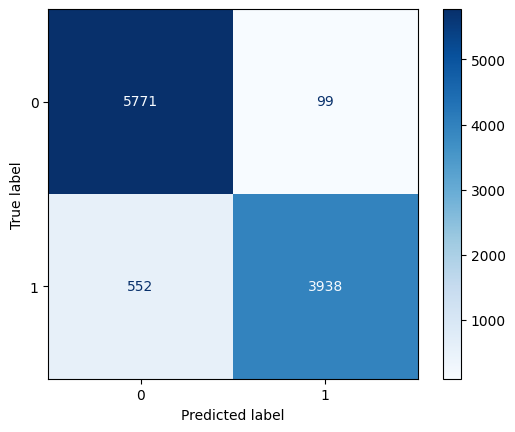

In [323]:
Check()